# Install Libraries

In [1]:
pip install tensorflow-addons

Note: you may need to restart the kernel to use updated packages.


In [2]:
pip install tensorflow==2.2.0-rc3

Note: you may need to restart the kernel to use updated packages.


ERROR: Could not find a version that satisfies the requirement tensorflow==2.2.0-rc3 (from versions: 2.5.0, 2.5.1, 2.5.2, 2.5.3, 2.6.0rc0, 2.6.0rc1, 2.6.0rc2, 2.6.0, 2.6.1, 2.6.2, 2.6.3, 2.6.4, 2.6.5, 2.7.0rc0, 2.7.0rc1, 2.7.0, 2.7.1, 2.7.2, 2.7.3, 2.8.0rc0, 2.8.0rc1, 2.8.0, 2.8.1, 2.8.2, 2.9.0rc0, 2.9.0rc1, 2.9.0rc2, 2.9.0, 2.9.1, 2.10.0rc0)
ERROR: No matching distribution found for tensorflow==2.2.0-rc3


In [3]:
pip install tensorflow

Note: you may need to restart the kernel to use updated packages.


# Importing libraries

In [1]:
from keras.utils.metrics_utils import ConfusionMatrix
import numpy as np
import pandas as pd

#Visualization
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

#sklearn
from sklearn.preprocessing import LabelEncoder,StandardScaler
from sklearn.metrics import confusion_matrix, classification_report,ConfusionMatrixDisplay,accuracy_score
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

#Tensorflow
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import tensorflow_addons as tfa
from keras.models import Sequential,model_from_json
from keras.layers.core import Dense,Activation,Dropout
import tensorflow_addons as tfa
from tensorflow.keras.callbacks import ModelCheckpoint

# Importing the datasets

In [2]:
train = pd.read_csv("train.csv")
test = pd.read_csv("test.csv")
val = pd.read_csv("val.csv")
train.head()

,Switch ID,Port Number,Received Packets,Received Bytes,Sent Bytes,Sent Packets,Port alive Duration (S),Delta Received Packets,Delta Received Bytes,Delta Sent Bytes,...,Connection Point,Total Load/Rate,Total Load/Latest,Unknown Load/Rate,Unknown Load/Latest,Latest bytes counter,Active Flow Entries,Packets Looked Up,Packets Matched,Label
0,of:0000000000000004,Port#:1,240,16586,12622603,467,126,0,0,280,...,1,0,0,0,0,0,4,819,757,TCP-SYN
1,of:0000000000000004,Port#:2,158,20530,35464,376,171,4,556,3407,...,2,0,0,0,0,0,5,1018,918,TCP-SYN
2,of:0000000000000008,Port#:3,1930,37881404,67857371,414333,1297,0,0,556,...,2,0,0,0,0,0,8,987400,987276,Normal
3,of:0000000000000001,Port#:4,903,18946410,17900326,98088,176,3,320,270280,...,3,0,0,0,0,0,8,195879,195780,PortScan
4,of:000000000000000b,Port#:1,423,29020,19138042,1562,1451,0,0,560,...,1,0,0,0,0,0,4,4524,4411,Overflow


In [3]:
test.head()

,Switch ID,Port Number,Received Packets,Received Bytes,Sent Bytes,Sent Packets,Port alive Duration (S),Delta Received Packets,Delta Received Bytes,Delta Sent Bytes,...,Connection Point,Total Load/Rate,Total Load/Latest,Unknown Load/Rate,Unknown Load/Latest,Latest bytes counter,Active Flow Entries,Packets Looked Up,Packets Matched,Label
0,of:0000000000000004,Port#:2,117,15705,15537,113,126,2,278,348,...,3,0,0,0,0,0,6,2350,2265,TCP-SYN
1,of:000000000000000a,Port#:4,349224,14743367,38139845,156153,1430,4,556,560,...,4,0,0,0,0,0,4,649491,649367,Normal
2,of:000000000000000a,Port#:2,127,8855,6316408,271,96,0,0,280,...,2,0,0,0,0,0,6,3933,3848,TCP-SYN
3,of:0000000000000005,Port#:3,1396,25241475,31751210,2853,2172,178,4992757,7565,...,1,0,0,0,0,0,8,10237,10113,Blackhole
4,of:000000000000000a,Port#:1,12,1016,13549,101,101,0,0,556,...,2,0,0,0,0,0,10,6269,6181,TCP-SYN


In [4]:
val.head()

,Switch ID,Port Number,Received Packets,Received Bytes,Sent Bytes,Sent Packets,Port alive Duration (S),Delta Received Packets,Delta Received Bytes,Delta Sent Bytes,...,Connection Point,Total Load/Rate,Total Load/Latest,Unknown Load/Rate,Unknown Load/Latest,Latest bytes counter,Active Flow Entries,Packets Looked Up,Packets Matched,Label
0,of:000000000000000a,Port#:1,2594,75671796,31757809,3308,1672,0,0,560,...,2,0,0,0,0,0,6,12271,12057,Diversion
1,of:0000000000000002,Port#:1,10,856,9732,74,61,0,0,348,...,2,0,0,0,0,0,8,778,697,TCP-SYN
2,of:000000000000000a,Port#:3,2192,12805806,31695352,2412,1566,57,1839337,2615,...,2,0,0,0,0,0,6,6233,6156,Blackhole
3,of:0000000000000002,Port#:1,401,6327186,24401,240,131,85,6316,759,...,4,0,0,0,0,0,6,1228,1134,PortScan
4,of:0000000000000002,Port#:1,3799,82050574,88575612,5526,2547,0,0,556,...,1,0,0,0,0,0,4,10977,10896,Blackhole


#  Exploratory Data Analysis (EDA)

## Manipulate the datasets

In [5]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2619 entries, 0 to 2618
Data columns (total 22 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   Switch ID                      2619 non-null   object
 1   Port Number                    2619 non-null   object
 2   Received Packets               2619 non-null   int64 
 3   Received Bytes                 2619 non-null   int64 
 4   Sent Bytes                     2619 non-null   int64 
 5   Sent Packets                   2619 non-null   int64 
 6   Port alive Duration (S)        2619 non-null   int64 
 7   Delta Received Packets         2619 non-null   int64 
 8   Delta Received Bytes           2619 non-null   int64 
 9   Delta Sent Bytes               2619 non-null   int64 
 10  Delta Sent Packets             2619 non-null   int64 
 11  Delta Port alive Duration (S)  2619 non-null   int64 
 12  Connection Point               2619 non-null   int64 
 13  Tot

In [6]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 561 entries, 0 to 560
Data columns (total 22 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   Switch ID                      561 non-null    object
 1   Port Number                    561 non-null    object
 2   Received Packets               561 non-null    int64 
 3   Received Bytes                 561 non-null    int64 
 4   Sent Bytes                     561 non-null    int64 
 5   Sent Packets                   561 non-null    int64 
 6   Port alive Duration (S)        561 non-null    int64 
 7   Delta Received Packets         561 non-null    int64 
 8   Delta Received Bytes           561 non-null    int64 
 9   Delta Sent Bytes               561 non-null    int64 
 10  Delta Sent Packets             561 non-null    int64 
 11  Delta Port alive Duration (S)  561 non-null    int64 
 12  Connection Point               561 non-null    int64 
 13  Total

In [7]:
val.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 561 entries, 0 to 560
Data columns (total 22 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   Switch ID                      561 non-null    object
 1   Port Number                    561 non-null    object
 2   Received Packets               561 non-null    int64 
 3   Received Bytes                 561 non-null    int64 
 4   Sent Bytes                     561 non-null    int64 
 5   Sent Packets                   561 non-null    int64 
 6   Port alive Duration (S)        561 non-null    int64 
 7   Delta Received Packets         561 non-null    int64 
 8   Delta Received Bytes           561 non-null    int64 
 9   Delta Sent Bytes               561 non-null    int64 
 10  Delta Sent Packets             561 non-null    int64 
 11  Delta Port alive Duration (S)  561 non-null    int64 
 12  Connection Point               561 non-null    int64 
 13  Total

##Checking for NULL values

In [8]:
train.isnull().sum()

Switch ID                        0
Port Number                      0
Received Packets                 0
Received Bytes                   0
Sent Bytes                       0
Sent Packets                     0
Port alive Duration (S)          0
Delta Received Packets           0
Delta Received Bytes             0
Delta Sent Bytes                 0
Delta Sent Packets               0
Delta Port alive Duration (S)    0
Connection Point                 0
Total Load/Rate                  0
Total Load/Latest                0
Unknown Load/Rate                0
Unknown Load/Latest              0
Latest bytes counter             0
Active Flow Entries              0
Packets Looked Up                0
Packets Matched                  0
Label                            0
dtype: int64

In [9]:
test.isnull().sum()

Switch ID                        0
Port Number                      0
Received Packets                 0
Received Bytes                   0
Sent Bytes                       0
Sent Packets                     0
Port alive Duration (S)          0
Delta Received Packets           0
Delta Received Bytes             0
Delta Sent Bytes                 0
Delta Sent Packets               0
Delta Port alive Duration (S)    0
Connection Point                 0
Total Load/Rate                  0
Total Load/Latest                0
Unknown Load/Rate                0
Unknown Load/Latest              0
Latest bytes counter             0
Active Flow Entries              0
Packets Looked Up                0
Packets Matched                  0
Label                            0
dtype: int64

In [10]:
val.isnull().sum()

Switch ID                        0
Port Number                      0
Received Packets                 0
Received Bytes                   0
Sent Bytes                       0
Sent Packets                     0
Port alive Duration (S)          0
Delta Received Packets           0
Delta Received Bytes             0
Delta Sent Bytes                 0
Delta Sent Packets               0
Delta Port alive Duration (S)    0
Connection Point                 0
Total Load/Rate                  0
Total Load/Latest                0
Unknown Load/Rate                0
Unknown Load/Latest              0
Latest bytes counter             0
Active Flow Entries              0
Packets Looked Up                0
Packets Matched                  0
Label                            0
dtype: int64

## Number of instances per class

In [11]:
train.Label.value_counts()

PortScan     666
TCP-SYN      651
Blackhole    561
Diversion    414
Normal       254
Overflow      73
Name: Label, dtype: int64

In [12]:
test.Label.value_counts()

TCP-SYN      156
PortScan     127
Blackhole    122
Diversion     90
Normal        49
Overflow      17
Name: Label, dtype: int64

In [13]:
val.Label.value_counts()

Blackhole    143
PortScan     141
TCP-SYN      123
Diversion     92
Normal        47
Overflow      15
Name: Label, dtype: int64

## Basic statistical analysis for every feature

In [14]:
train.describe()

,Received Packets,Received Bytes,Sent Bytes,Sent Packets,Port alive Duration (S),Delta Received Packets,Delta Received Bytes,Delta Sent Bytes,Delta Sent Packets,Delta Port alive Duration (S),Connection Point,Total Load/Rate,Total Load/Latest,Unknown Load/Rate,Unknown Load/Latest,Latest bytes counter,Active Flow Entries,Packets Looked Up,Packets Matched
count,2619.000000,2.619000e+03,2.619000e+03,2619.000000,2619.000000,2619.000000,2.619000e+03,2.619000e+03,2619.000000,2619.000000,2619.000000,2.619000e+03,2.619000e+03,2.619000e+03,2.619000e+03,2.619000e+03,2619.000000,2.619000e+03,2.619000e+03
mean,19929.095074,2.606639e+07,2.372645e+07,33676.567774,890.539137,174.948835,3.254661e+05,2.957171e+05,160.607866,4.831615,2.450935,2.044276e+04,5.033087e+05,2.044276e+04,5.033087e+05,2.044276e+04,94.972890,9.920463e+04,9.908445e+04
std,61817.860816,3.670801e+07,3.309908e+07,90565.150583,970.916789,1028.907797,1.166624e+06,1.107859e+06,972.484039,0.374279,1.159286,1.141013e+05,1.796231e+06,1.141013e+05,1.796231e+06,1.141013e+05,828.181086,2.363175e+05,2.363162e+05
min,10.000000,8.560000e+02,6.025000e+03,44.000000,26.000000,0.000000,0.000000e+00,2.780000e+02,2.000000,4.000000,1.000000,-6.446240e+05,0.000000e+00,-6.446240e+05,0.000000e+00,-6.446240e+05,4.000000,1.050000e+02,5.000000e+01
25%,321.500000,8.464900e+04,5.360900e+04,333.500000,136.000000,2.000000,2.780000e+02,2.800000e+02,2.000000,5.000000,1.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,5.000000,2.263000e+03,2.147000e+03
50%,1108.000000,1.262083e+07,1.262176e+07,1243.000000,254.000000,4.000000,5.560000e+02,5.560000e+02,4.000000,5.000000,2.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,6.000000,6.968000e+03,6.843000e+03
75%,3268.500000,3.736785e+07,3.170219e+07,3727.000000,1721.000000,6.000000,8.310000e+02,7.590000e+02,5.000000,5.000000,3.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,8.000000,2.163300e+04,2.140800e+04
max,352584.000000,2.589422e+08,2.130728e+08,420806.000000,3317.000000,15588.000000,6.171714e+06,6.302910e+06,15593.000000,5.000000,5.000000,1.260657e+06,1.275386e+07,1.260657e+06,1.275386e+07,1.260657e+06,9985.000000,1.012220e+06,1.012085e+06


In [15]:
test.describe()

,Received Packets,Received Bytes,Sent Bytes,Sent Packets,Port alive Duration (S),Delta Received Packets,Delta Received Bytes,Delta Sent Bytes,Delta Sent Packets,Delta Port alive Duration (S),Connection Point,Total Load/Rate,Total Load/Latest,Unknown Load/Rate,Unknown Load/Latest,Latest bytes counter,Active Flow Entries,Packets Looked Up,Packets Matched
count,561.000000,5.610000e+02,5.610000e+02,561.000000,561.000000,561.000000,5.610000e+02,5.610000e+02,561.000000,561.000000,561.00000,5.610000e+02,5.610000e+02,5.610000e+02,5.610000e+02,5.610000e+02,561.000000,5.610000e+02,5.610000e+02
mean,23141.636364,2.726677e+07,2.438093e+07,30155.998217,910.654189,149.048128,4.546660e+05,3.171120e+05,169.782531,4.841355,2.44385,1.992058e+04,6.084924e+05,1.992058e+04,6.084924e+05,1.992058e+04,61.912656,9.053312e+04,9.041352e+04
std,69278.589077,3.627827e+07,3.439084e+07,82370.302150,981.303212,861.268543,1.381151e+06,1.207563e+06,1030.484551,0.365671,1.20006,1.105112e+05,1.985467e+06,1.105112e+05,1.985467e+06,1.105112e+05,601.548185,2.235338e+05,2.235324e+05
min,10.000000,8.560000e+02,6.854000e+03,49.000000,26.000000,0.000000,0.000000e+00,2.780000e+02,2.000000,4.000000,1.00000,-4.042080e+05,0.000000e+00,-4.042080e+05,0.000000e+00,-4.042080e+05,4.000000,1.790000e+02,9.800000e+01
25%,353.000000,1.042010e+05,4.480100e+04,322.000000,136.000000,2.000000,2.780000e+02,2.800000e+02,2.000000,5.000000,1.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,5.000000,2.346000e+03,2.238000e+03
50%,1376.000000,1.267023e+07,1.262299e+07,1215.000000,256.000000,4.000000,5.560000e+02,5.560000e+02,4.000000,5.000000,2.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,6.000000,7.066000e+03,6.929000e+03
75%,3562.000000,3.809469e+07,3.176783e+07,4054.000000,1742.000000,19.000000,1.823000e+03,7.590000e+02,5.000000,5.000000,3.00000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,8.000000,1.963300e+04,1.940900e+04
max,352572.000000,2.589394e+08,2.138743e+08,420932.000000,3307.000000,11130.000000,6.323770e+06,6.647966e+06,13840.000000,5.000000,5.00000,1.194922e+06,1.264637e+07,1.194922e+06,1.264637e+07,1.194922e+06,9980.000000,1.009529e+06,1.009394e+06


In [16]:
val.describe()

,Received Packets,Received Bytes,Sent Bytes,Sent Packets,Port alive Duration (S),Delta Received Packets,Delta Received Bytes,Delta Sent Bytes,Delta Sent Packets,Delta Port alive Duration (S),Connection Point,Total Load/Rate,Total Load/Latest,Unknown Load/Rate,Unknown Load/Latest,Latest bytes counter,Active Flow Entries,Packets Looked Up,Packets Matched
count,561.000000,5.610000e+02,5.610000e+02,561.000000,561.000000,561.000000,5.610000e+02,5.610000e+02,561.000000,561.000000,561.000000,5.610000e+02,5.610000e+02,5.610000e+02,5.610000e+02,5.610000e+02,561.000000,5.610000e+02,5.610000e+02
mean,20265.901961,2.651052e+07,2.462073e+07,26309.124777,949.360071,238.839572,3.268137e+05,2.927781e+05,162.711230,4.846702,2.422460,1.349392e+04,4.418708e+05,1.349392e+04,4.418708e+05,1.349392e+04,62.071301,8.382923e+04,8.370799e+04
std,59032.911054,3.505715e+07,3.420225e+07,75202.041514,977.609275,1149.069110,1.181636e+06,1.106077e+06,909.905479,0.360596,1.150215,9.124726e+04,1.725488e+06,9.124726e+04,1.725488e+06,9.124726e+04,601.962008,2.056357e+05,2.056371e+05
min,10.000000,8.560000e+02,7.202000e+03,50.000000,36.000000,0.000000,0.000000e+00,2.780000e+02,2.000000,4.000000,1.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,4.000000,1.400000e+02,8.400000e+01
25%,379.000000,1.962210e+06,4.856800e+04,377.000000,141.000000,2.000000,2.780000e+02,2.800000e+02,2.000000,5.000000,1.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,5.000000,2.462000e+03,2.350000e+03
50%,1385.000000,1.266395e+07,1.263028e+07,1239.000000,317.000000,4.000000,5.560000e+02,5.560000e+02,4.000000,5.000000,2.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,6.000000,8.105000e+03,7.979000e+03
75%,3642.000000,3.785762e+07,3.176313e+07,3889.000000,1750.000000,5.000000,6.260000e+02,7.590000e+02,5.000000,5.000000,3.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,8.000000,2.073500e+04,2.060700e+04
max,350280.000000,2.652568e+08,1.837435e+08,419567.000000,3287.000000,11273.000000,6.249706e+06,6.302708e+06,11273.000000,5.000000,5.000000,1.260664e+06,1.273210e+07,1.260664e+06,1.273210e+07,1.260664e+06,9979.000000,1.009010e+06,1.008875e+06


## Checking for outlier

In [17]:
def boxplot(column,data):
    sns.boxplot(x = column,data = data)

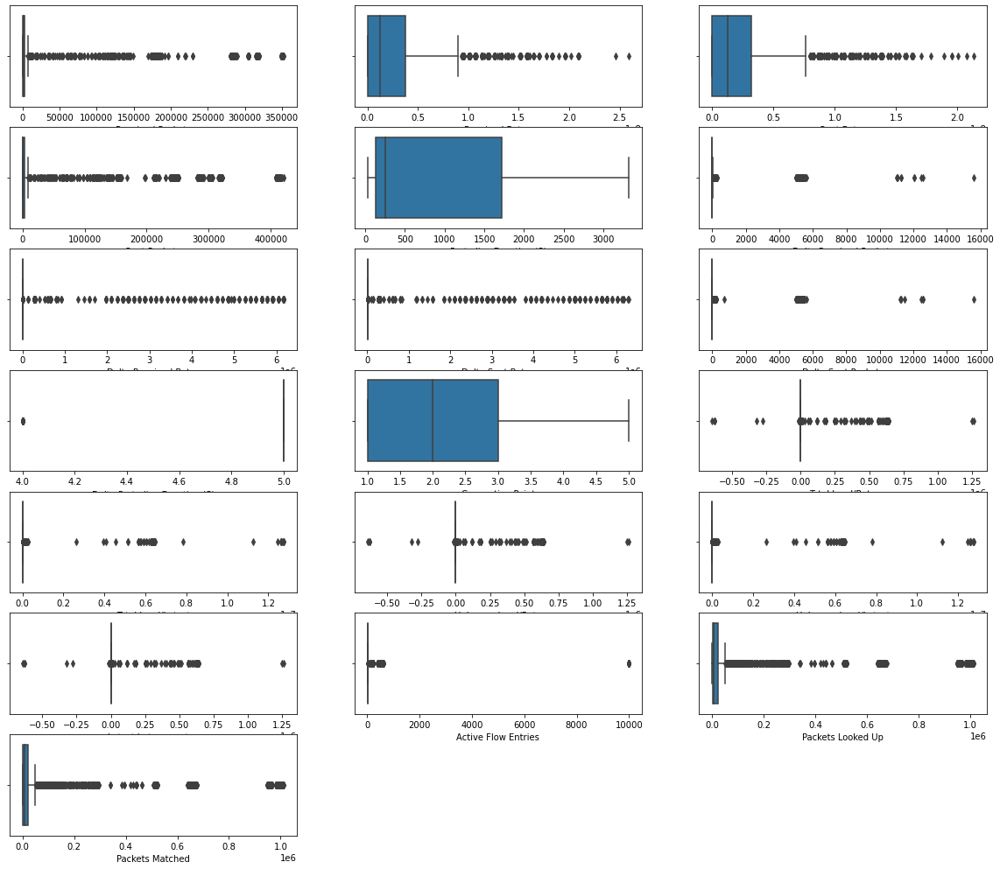

In [18]:
plt.figure(figsize=(20, 20))
for i in range(2,len(train.columns)-1):
    plt.subplot(8,3,i-1)
    boxplot(train.columns[i],train)

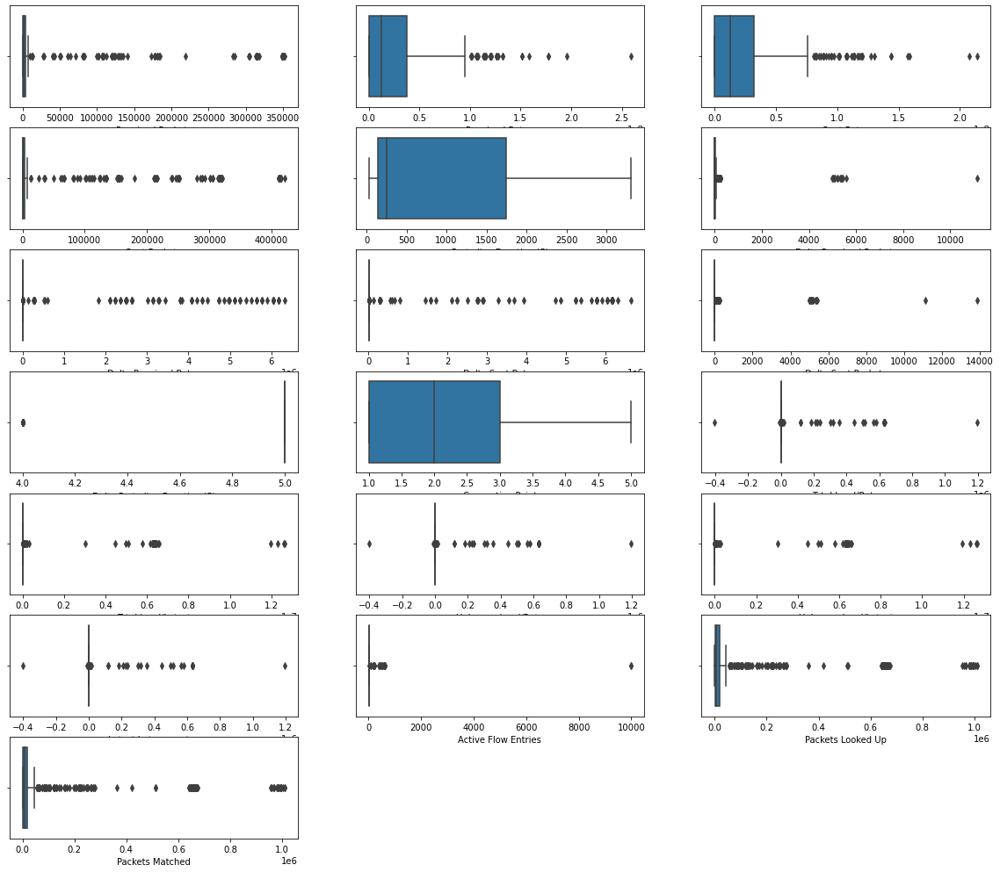

In [19]:
plt.figure(figsize=(20, 20))
for i in range(2,len(test.columns)-1):
    plt.subplot(8,3,i-1)
    boxplot(test.columns[i],test)

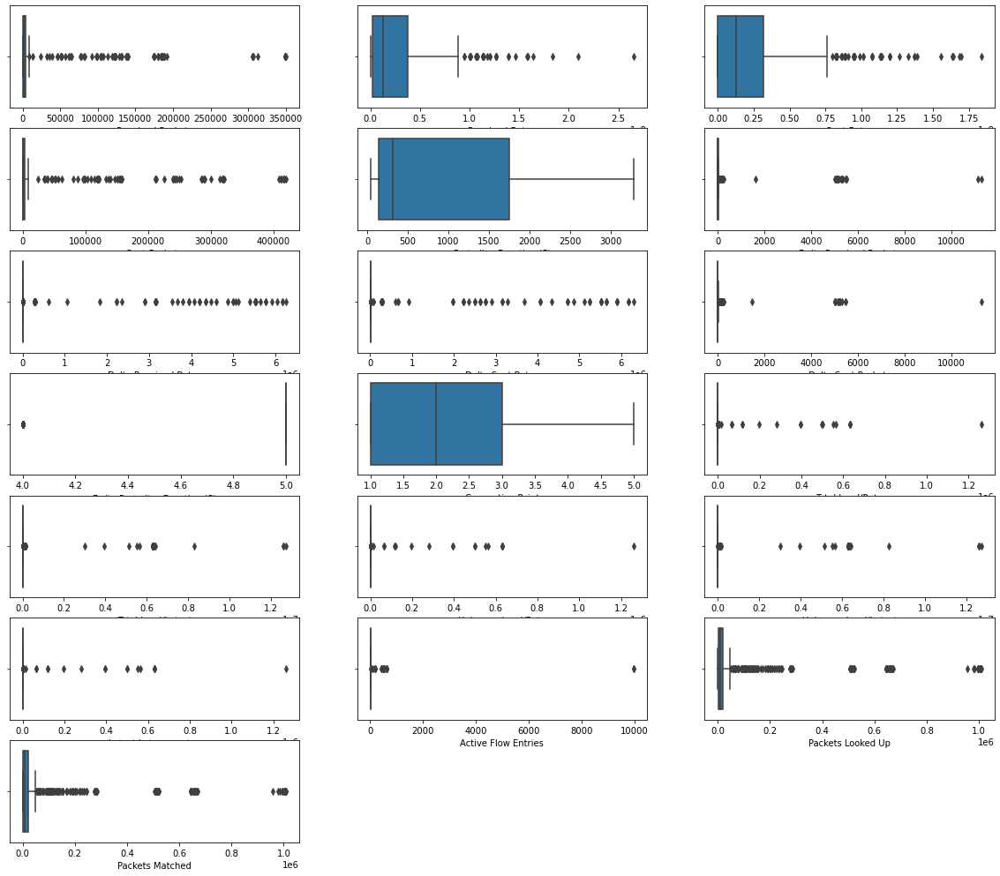

In [20]:
plt.figure(figsize=(20, 20))
for i in range(2,len(val.columns)-1):
    plt.subplot(8,3,i-1)
    boxplot(val.columns[i],val)

## Label Encoder

In [21]:
def label_encoder(col):
    le = LabelEncoder()
    train[col] = le.fit_transform(train[col])
    test[col] = le.transform(test[col])
    val[col] = le.transform(val[col])
    print(train[col])
    print(test[col])
    print(val[col])

In [22]:
train['Label'].unique()

array(['TCP-SYN', 'Normal', 'PortScan', 'Overflow', 'Diversion',
       'Blackhole'], dtype=object)

In [23]:
label_encoder('Label')

0       5
1       5
2       2
3       4
4       3
       ..
2614    4
2615    0
2616    5
2617    0
2618    5
Name: Label, Length: 2619, dtype: int32
0      5
1      2
2      5
3      0
4      5
      ..
556    1
557    0
558    5
559    5
560    4
Name: Label, Length: 561, dtype: int32
0      1
1      5
2      0
3      4
4      0
      ..
556    5
557    2
558    1
559    2
560    1
Name: Label, Length: 561, dtype: int32


In [24]:
train['Port Number'].unique()

array(['Port#:1', 'Port#:2', 'Port#:3', 'Port#:4'], dtype=object)

In [25]:
label_encoder('Port Number')

0       0
1       1
2       2
3       3
4       0
       ..
2614    0
2615    1
2616    2
2617    1
2618    1
Name: Port Number, Length: 2619, dtype: int32
0      1
1      3
2      1
3      2
4      0
      ..
556    0
557    1
558    0
559    2
560    2
Name: Port Number, Length: 561, dtype: int32
0      0
1      0
2      2
3      0
4      0
      ..
556    2
557    3
558    1
559    1
560    1
Name: Port Number, Length: 561, dtype: int32


In [26]:
train['Switch ID'].unique()

array(['of:0000000000000004', 'of:0000000000000008',
       'of:0000000000000001', 'of:000000000000000b',
       'of:000000000000000c', 'of:0000000000000003',
       'of:0000000000000006', 'of:000000000000000a',
       'of:0000000000000007', 'of:0000000000000009',
       'of:0000000000000005', 'of:0000000000000002'], dtype=object)

In [27]:
label_encoder('Switch ID')

0        3
1        3
2        7
3        0
4       10
        ..
2614     7
2615    10
2616    11
2617    11
2618     0
Name: Switch ID, Length: 2619, dtype: int32
0       3
1       9
2       9
3       4
4       9
       ..
556    11
557     7
558     0
559     4
560     9
Name: Switch ID, Length: 561, dtype: int32
0       9
1       1
2       9
3       1
4       1
       ..
556     4
557     9
558    10
559    10
560     7
Name: Switch ID, Length: 561, dtype: int32


## Splitting

In [28]:
x_train = train.iloc[:,:-1].values
y_train = train.iloc[:,-1].values
print(x_train)
print(y_train)

[[     3      0    240 ...      4    819    757]
 [     3      1    158 ...      5   1018    918]
 [     7      2   1930 ...      8 987400 987276]
 ...
 [    11      2    386 ...      8   2688   2590]
 [    11      1    807 ...      6   3088   2976]
 [     0      1    545 ...      6   1584   1488]]
[5 5 2 ... 5 0 5]


In [29]:
x_test = test.iloc[:,:-1].values
y_test = test.iloc[:,-1].values
print(x_test)
print(y_test)

[[     3      1    117 ...      6   2350   2265]
 [     9      3 349224 ...      4 649491 649367]
 [     9      1    127 ...      6   3933   3848]
 ...
 [     0      0    472 ...      5   1706   1596]
 [     4      2    253 ...      6   5780   5668]
 [     9      2    677 ...      6   1443   1356]]
[5 2 5 0 5 0 5 5 1 4 0 4 0 4 0 2 4 1 0 5 3 4 5 5 4 0 1 4 1 0 1 4 4 5 5 5 1
 2 4 0 4 2 0 1 2 5 5 5 3 2 0 5 5 4 2 0 5 1 5 0 0 0 5 4 4 4 4 4 5 2 1 4 2 5
 5 1 4 2 5 0 5 5 4 1 5 0 0 0 4 4 4 4 4 4 0 4 5 0 0 0 5 0 1 1 5 0 3 0 5 5 1
 2 1 5 5 4 5 4 5 5 4 2 0 2 4 4 0 4 1 1 0 5 5 5 5 0 0 0 3 1 0 1 3 0 4 0 1 4
 5 5 0 5 1 0 1 4 1 3 5 5 1 5 4 5 1 0 5 4 1 0 1 4 0 0 5 1 2 4 0 1 4 5 5 1 5
 5 5 4 1 5 5 0 4 5 1 4 5 4 4 2 0 1 4 0 5 0 0 0 2 4 2 4 5 2 0 0 5 1 5 5 2 2
 5 4 0 4 5 1 4 4 1 1 4 1 0 2 1 0 1 1 4 5 4 1 2 5 1 0 5 5 5 4 1 5 4 5 2 3 2
 1 3 0 4 1 5 5 5 5 0 2 0 5 1 5 4 5 1 5 1 1 4 5 2 5 0 5 0 5 4 4 1 4 5 5 0 1
 5 3 4 0 1 5 2 4 0 4 0 0 0 0 0 5 2 0 5 4 1 1 5 4 5 2 1 1 4 5 1 5 1 2 2 4 4
 5 5 0 4 0 0 4 1 1 5 4 1 

In [30]:
x_val = val.iloc[:,:-1].values
y_val = val.iloc[:,-1].values
print(x_val)
print(y_val)

[[     9      0   2594 ...      6  12271  12057]
 [     1      0     10 ...      8    778    697]
 [     9      2   2192 ...      6   6233   6156]
 ...
 [    10      1   1736 ...      4   6950   6779]
 [    10      1 187954 ...      5 519051 518963]
 [     7      1   3820 ...      8  13201  13031]]
[1 5 0 4 0 4 4 3 0 0 5 0 4 1 4 2 0 1 5 0 5 1 1 4 3 0 5 0 0 5 5 5 1 0 0 1 0
 1 1 4 0 4 5 4 1 0 1 2 4 5 5 4 4 4 5 5 0 5 4 0 1 1 4 0 4 5 4 0 0 5 1 5 0 1
 3 0 1 5 0 0 1 2 5 5 0 0 0 0 0 4 2 0 0 0 2 5 4 4 4 4 5 0 4 0 0 4 5 4 0 4 1
 4 0 2 2 0 4 4 4 5 4 2 0 1 5 4 4 4 0 0 4 4 2 0 5 5 5 5 0 5 0 0 0 1 0 0 5 4
 3 5 0 4 2 2 0 2 1 1 0 0 5 2 0 0 4 0 0 4 0 4 3 0 4 4 1 5 4 5 1 1 5 5 1 0 2
 5 4 5 2 5 2 5 4 2 3 0 1 0 0 4 1 1 4 0 1 5 5 1 5 5 5 5 5 1 0 5 1 4 1 0 0 0
 1 1 4 4 5 4 2 0 5 1 1 1 0 0 4 3 0 5 1 0 2 0 4 0 0 3 0 1 2 3 0 1 4 0 4 4 5
 4 4 0 5 5 5 4 1 1 4 4 4 4 4 0 1 1 4 0 4 0 3 5 0 2 2 5 5 4 4 2 4 4 0 5 5 1
 1 0 5 1 0 5 0 4 5 0 4 0 0 5 4 4 5 2 4 3 1 2 0 2 4 5 0 5 2 4 4 4 1 1 0 0 5
 5 0 0 5 5 5 1 1 5 0 4 5 

## Scaling

In [31]:
scaler = StandardScaler()
x_train = scaler.fit_transform(x_train)
x_test = scaler.transform(x_test)
x_val = scaler.transform(x_val)

#  MLP classifier baseline performance

In [140]:
def mlp(x1,x2,x3,y1,y2,y3,neurons,active,lr,epochs,batch_size):
    model = Sequential()
    model.add(Dense(neurons,input_dim = x1.shape[1]))
    model.add(Activation(active))
    model.add(Dense(6))
    model.add(Activation(active))
    optimizer = tfa.optimizers.AdamW(learning_rate = lr, weight_decay = 0.0001)
    model.compile(loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True), optimizer =optimizer, metrics = ['accuracy'])
    history = model.fit(x1,y1,validation_data = [x2,y2], epochs = epochs,batch_size = batch_size, verbose = True)
    y_pred = model.predict(x3)
    return history,y_pred

In [142]:
metrics = []
reports = []
train_acc = []
test_acc = []
train_loss = []
test_loss = []
train = []
test = []
val = []
y_pred = []
for i in range(5):
    history, y_pred_base= mlp(x_train,x_test,x_val,y_train,y_test,y_val,10,"relu",0.001,500,1)
    y_pred_baseline = []
    for i in range(len(y_pred_base)):
        y_pred_baseline.append(np.argmax(y_pred_base[i]))
    y_pred.append(y_pred_baseline)
    cm = confusion_matrix(y_val, y_pred_baseline)
    metrics.append(cm)
    report = classification_report(y_val,y_pred_baseline)
    reports.append(report)
    train.append(model.evaluate(x_train, y_train)[1])
    test.append(model.evaluate(x_test, y_test)[1])
    val.append(model.evaluate(x_val, y_val)[1])
    train_acc.append(history.history['accuracy'])
    test_acc.append(history.history['val_accuracy'])
    train_loss.append(history.history['loss'])
    test_loss.append(history.history['val_loss'])

Epoch 1/500
2619/2619 [==============================] - 3s 1ms/step - loss: 1.4027 - accuracy: 0.4139 - val_loss: 0.9388 - val_accuracy: 0.6275
Epoch 2/500
2619/2619 [==============================] - 3s 1ms/step - loss: 0.8367 - accuracy: 0.6621 - val_loss: 0.7668 - val_accuracy: 0.7023
Epoch 3/500
2619/2619 [==============================] - 3s 974us/step - loss: 0.7650 - accuracy: 0.6880 - val_loss: 0.7434 - val_accuracy: 0.7201
Epoch 4/500
2619/2619 [==============================] - 3s 989us/step - loss: 0.7461 - accuracy: 0.6980 - val_loss: 0.7455 - val_accuracy: 0.7077
Epoch 5/500
2619/2619 [==============================] - 3s 1ms/step - loss: 0.7392 - accuracy: 0.7045 - val_loss: 0.7272 - val_accuracy: 0.7326
Epoch 6/500
2619/2619 [==============================] - 3s 967us/step - loss: 0.7338 - accuracy: 0.7129 - val_loss: 0.7367 - val_accuracy: 0.6898
Epoch 7/500
2619/2619 [==============================] - 2s 949us/step - loss: 0.7329 - accuracy: 0.7125 - val_loss: 0.7146 

C:\Users\EGYPT_LAPTOP\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\EGYPT_LAPTOP\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\EGYPT_LAPTOP\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


18/18 [==============================] - 0s 924us/step - loss: 1.1040 - accuracy: 0.5775
Epoch 1/500
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3059 - accuracy: 0.5013 - val_loss: 0.9468 - val_accuracy: 0.6381
Epoch 2/500
2619/2619 [==============================] - 3s 1ms/step - loss: 0.8683 - accuracy: 0.6598 - val_loss: 0.7968 - val_accuracy: 0.6970
Epoch 3/500
2619/2619 [==============================] - 3s 1ms/step - loss: 0.7913 - accuracy: 0.6861 - val_loss: 0.7460 - val_accuracy: 0.7273
Epoch 4/500
2619/2619 [==============================] - 3s 998us/step - loss: 0.7596 - accuracy: 0.7129 - val_loss: 0.7290 - val_accuracy: 0.7237
Epoch 5/500
2619/2619 [==============================] - 3s 1000us/step - loss: 0.7444 - accuracy: 0.7079 - val_loss: 0.7123 - val_accuracy: 0.7362
Epoch 6/500
2619/2619 [==============================] - 3s 1ms/step - loss: 0.7340 - accuracy: 0.7121 - val_loss: 0.7129 - val_accuracy: 0.7362
Epoch 7/500
2619/2619 [=============

In [127]:
def table1(train_acc,test_acc):
    
    train_min = min(train_acc)
    train_max = max(train_acc)
    train_avg = np.mean(train_acc)
    test_min = min(test_acc)
    test_max = max(test_acc)
    test_avg = np.mean(test_acc)
    
    print("Min training acc: ", train_min)
    print("Max training acc: ", train_max)
    print("Avg training acc: ", train_avg)
    print("Min testing acc: ", test_min)
    print("Max testing acc: ", test_max)
    print("Avg testing acc: ", test_avg)


In [147]:
train

[0.5589919686317444,
 0.5589919686317444,
 0.5589919686317444,
 0.5589919686317444,
 0.5589919686317444]

In [144]:
def table(train_acc,test_acc,val_acc):
    train_min = min(train_acc)
    train_max = max(train_acc)
    train_avg = np.mean(train_acc)
    test_min = min(test_acc)
    test_max = max(test_acc)
    test_avg = np.mean(test_acc)
    val_min = min(val_acc)
    val_max = max(val_acc)
    val_avg = np.mean(val_acc)
    print("Min training acc: ", train_min)
    print("Max training acc: ", train_max)
    print("Avg training acc: ", train_avg)
    print("Min testing acc: ", test_min)
    print("Max testing acc: ", test_max)
    print("Avg testing acc: ", test_avg)
    print("Min validation acc: ", val_min)
    print("Max validation acc: ", val_max)
    print("Avg validation acc: ", val_avg)

In [161]:
table(train,test,val)

Min training acc:  0.5589919686317444
Max training acc:  0.5589919686317444
Avg training acc:  0.5589919686317444
Min testing acc:  0.5900177955627441
Max testing acc:  0.5900177955627441
Avg testing acc:  0.5900177955627441
Min validation acc:  0.5775400996208191
Max validation acc:  0.5775400996208191
Avg validation acc:  0.5775400996208191


In [148]:
def plt_acc(acc,test_acc,i):
    plt.plot(acc)
    plt.plot(test_acc)
    plt.title(f'model accuracy {i}')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='upper left')
    plt.show()

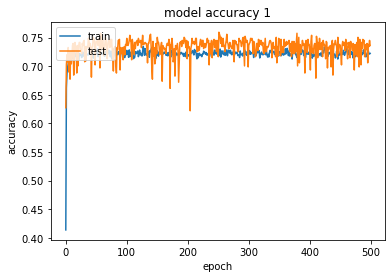

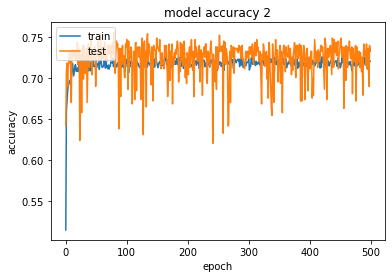

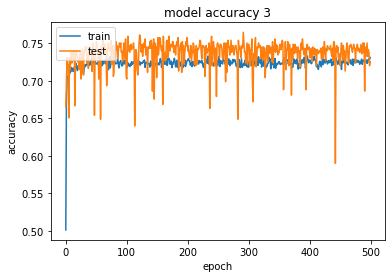

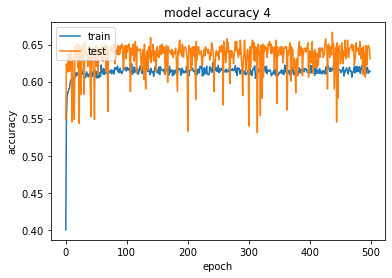

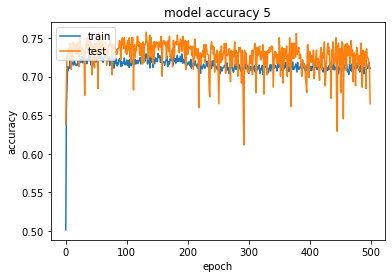

In [149]:
for i in range(5):
    plt_acc(train_acc[i],test_acc[i],i+1)

In [150]:
def plt_loss(loss,test_loss,i):
    plt.plot(loss)
    plt.plot(test_loss)
    plt.title(f'model loss {i}')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='upper left')
    plt.show()

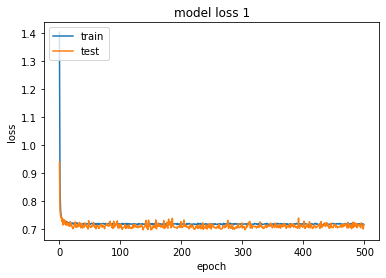

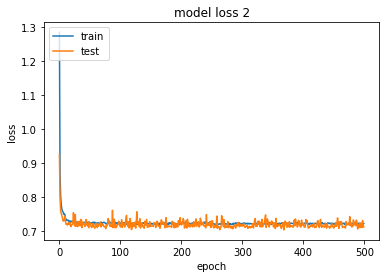

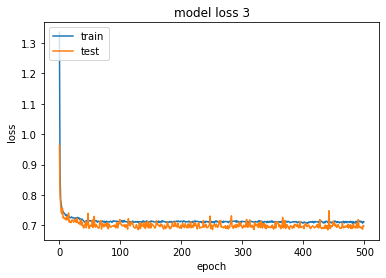

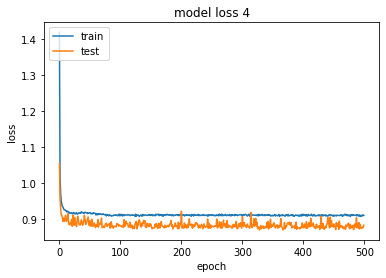

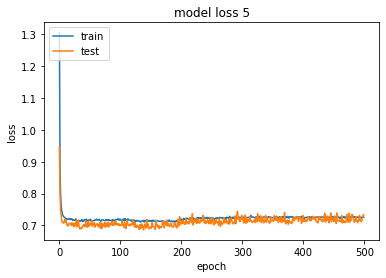

In [151]:
for i in range(5):
    plt_loss(train_loss[i],test_loss[i],i+1)

In [152]:
for i in range(5):
    print("Confusion matrix",i+1)
    print(metrics[i])

Confusion matrix 1
[[25 18  9  0 23 47]
 [25 16  5  0 18 26]
 [11  7  3  0  9 19]
 [ 5  1  1  0  6  4]
 [24 25 15  2 22 39]
 [37 25 14  0 39 41]]
Confusion matrix 2
[[24 19  9  0 17 53]
 [24 15  5  0 15 31]
 [11  7  3  0  7 21]
 [ 5  1  1  0  5  5]
 [23 24 14  2 15 49]
 [37 23 12  0 34 50]]
Confusion matrix 3
[[19 24  9  0 20 50]
 [19 20  5  0 18 28]
 [11  7  3  0  8 20]
 [ 5  1  1  0  6  4]
 [21 27 14  2 19 44]
 [34 27 12  0 36 47]]
Confusion matrix 4
[[32 17  0  0 21 52]
 [30 13  0  0 20 27]
 [13  7  0  0  8 21]
 [ 6  1  0  0  6  4]
 [33 24  0  0 27 43]
 [48 21  0  0 40 47]]
Confusion matrix 5
[[34  9  9  0 39 31]
 [32  9  5  0 30 14]
 [14  4  3  0 17 11]
 [ 5  1  1  0  6  4]
 [33 16 15  2 33 28]
 [45 18 13  0 55 25]]


In [153]:
for i in range(5):
    print("Classification reports",i+1)
    print(reports[i])

Classification reports 1
              precision    recall  f1-score   support

           0       0.20      0.20      0.20       122
           1       0.17      0.18      0.18        90
           2       0.06      0.06      0.06        49
           3       0.00      0.00      0.00        17
           4       0.19      0.17      0.18       127
           5       0.23      0.26      0.25       156

    accuracy                           0.19       561
   macro avg       0.14      0.15      0.14       561
weighted avg       0.18      0.19      0.19       561

Classification reports 2
              precision    recall  f1-score   support

           0       0.19      0.20      0.20       122
           1       0.17      0.17      0.17        90
           2       0.07      0.06      0.06        49
           3       0.00      0.00      0.00        17
           4       0.16      0.12      0.14       127
           5       0.24      0.32      0.27       156

    accuracy               

In [154]:
def tsne(x,y):
    Tsne = TSNE(n_components = 2,random_state = 0)
    tsne_results = Tsne.fit_transform(x)
    df = pd.DataFrame()
    df['feature 1'] = tsne_results[:,0]
    df['feature 2'] = tsne_results[:,1]
    df['y'] = y
    sns.scatterplot(x = 'feature 1', y = 'feature 2', hue = df.y.tolist(), data = df)

C:\Users\EGYPT_LAPTOP\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\EGYPT_LAPTOP\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
C:\Users\EGYPT_LAPTOP\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\EGYPT_LAPTOP\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
C:\Users\EGYPT_LAPTOP\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\EGYPT_LAPTOP\anaconda3\lib\site-packa

Text(0.5, 1.0, 'TSNE for validation set for baseline')

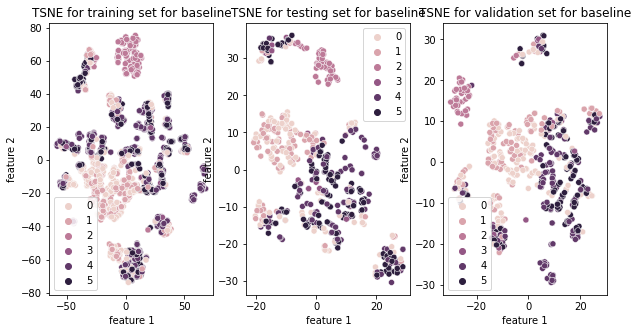

In [155]:
plt.figure(figsize=(10, 5))
plt.subplot(1,3,1)
train_tsne = tsne(x_train,y_train)
plt.title("TSNE for training set for baseline")
plt.subplot(1,3,2)
train_tsne = tsne(x_test,y_test)
plt.title("TSNE for testing set for baseline")
plt.subplot(1,3,3)
train_tsne = tsne(x_val,y_val)
plt.title("TSNE for validation set for baseline")

In [156]:
y_pred

[[1,
  5,
  0,
  5,
  1,
  4,
  5,
  5,
  5,
  0,
  5,
  0,
  4,
  1,
  4,
  2,
  0,
  1,
  5,
  0,
  5,
  1,
  1,
  4,
  4,
  0,
  5,
  1,
  0,
  5,
  4,
  5,
  1,
  0,
  4,
  5,
  0,
  1,
  1,
  5,
  0,
  4,
  5,
  4,
  1,
  0,
  5,
  2,
  5,
  5,
  5,
  4,
  4,
  4,
  5,
  5,
  0,
  5,
  4,
  0,
  1,
  0,
  4,
  0,
  5,
  4,
  4,
  0,
  0,
  5,
  1,
  5,
  0,
  0,
  5,
  1,
  1,
  5,
  0,
  0,
  1,
  2,
  5,
  5,
  0,
  0,
  0,
  0,
  1,
  5,
  2,
  1,
  0,
  0,
  2,
  5,
  1,
  4,
  4,
  5,
  5,
  0,
  4,
  0,
  0,
  5,
  5,
  4,
  5,
  4,
  1,
  4,
  5,
  2,
  2,
  0,
  4,
  5,
  4,
  5,
  4,
  2,
  1,
  1,
  5,
  4,
  4,
  5,
  0,
  0,
  5,
  4,
  2,
  0,
  5,
  5,
  5,
  5,
  0,
  5,
  1,
  0,
  0,
  0,
  0,
  0,
  5,
  4,
  1,
  5,
  0,
  4,
  2,
  2,
  5,
  2,
  1,
  1,
  0,
  0,
  1,
  2,
  5,
  0,
  4,
  0,
  1,
  5,
  0,
  4,
  5,
  0,
  5,
  4,
  1,
  5,
  5,
  5,
  0,
  0,
  4,
  5,
  0,
  5,
  2,
  5,
  4,
  5,
  2,
  5,
  2,
  5,
  5,
  2,
  0,
  5,
  0,
  0,
  1,
  4,


In [157]:
all_acc_base = []
for i in range(5):
    acc_base = accuracy_score(y_test,y_pred[i])
    all_acc_base.append(acc_base)
all_acc_base

[0.19073083778966132,
 0.19073083778966132,
 0.1925133689839572,
 0.21212121212121213,
 0.18538324420677363]

In [158]:
avg_acc_base = np.mean(all_acc_base)
avg_acc_base

0.19429590017825313

In [159]:
print("Average confusion matrix")

cm = np.mean(np.array(metrics),axis =0)
print(cm)

Average confusion matrix
[[26.8 17.4  7.2  0.  24.  46.6]
 [26.  14.6  4.   0.  20.2 25.2]
 [12.   6.4  2.4  0.   9.8 18.4]
 [ 5.2  1.   0.8  0.   5.8  4.2]
 [26.8 23.2 11.6  1.6 23.2 40.6]
 [40.2 22.8 10.2  0.  40.8 42. ]]


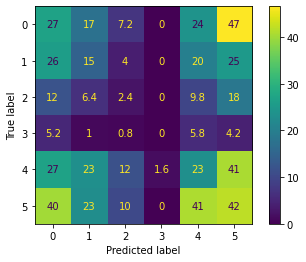

In [160]:
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()

# PCA

In [35]:
def pca(n_components,x_train,x_test,x_val):
    Pca = PCA(n_components = n_components,random_state =0)
    x_train_pca = Pca.fit_transform(x_train)
    x_test_pca = Pca.transform(x_test)
    x_val_pca = Pca.transform(x_test)
    return x_train_pca,x_test_pca,x_val_pca

In [64]:
acc_pca = []
for i in range(1,22):
    y_pred_pca = []
    x_train_pca,x_test_pca,x_val_pca = pca(i,x_train,x_test,x_val)
    history_pca,y_pca = mlp(x_train_pca,x_val_pca,x_test_pca,y_train,y_val,y_test,10,"relu",0.001,500,1)
    for i in range(len(y_pca)):
        y_pred_pca.append(np.argmax(y_pca[i]))
    acc_pca.append(accuracy_score(y_test,y_pred_pca))

Epoch 1/500
2619/2619 [==============================] - 3s 921us/step - loss: 1.7440 - accuracy: 0.2673 - val_loss: 1.7457 - val_accuracy: 0.2442
Epoch 2/500
2619/2619 [==============================] - 2s 890us/step - loss: 1.6784 - accuracy: 0.3020 - val_loss: 1.7503 - val_accuracy: 0.2478
Epoch 3/500
2619/2619 [==============================] - 2s 892us/step - loss: 1.6566 - accuracy: 0.3070 - val_loss: 1.7532 - val_accuracy: 0.2442
Epoch 4/500
2619/2619 [==============================] - 2s 893us/step - loss: 1.6430 - accuracy: 0.3127 - val_loss: 1.7523 - val_accuracy: 0.2442
Epoch 5/500
2619/2619 [==============================] - 2s 891us/step - loss: 1.6366 - accuracy: 0.3135 - val_loss: 1.7677 - val_accuracy: 0.2353
Epoch 6/500
2619/2619 [==============================] - 2s 908us/step - loss: 1.6323 - accuracy: 0.3165 - val_loss: 1.7574 - val_accuracy: 0.2478
Epoch 7/500
2619/2619 [==============================] - 2s 953us/step - loss: 1.6286 - accuracy: 0.3150 - val_loss: 1

In [65]:
def bar(acc_pca,acc_base,i):
    sns.barplot(x = np.arange(1,22),y = acc_pca)
    sns.lineplot(x=np.arange(1,22),y = acc_base)
    plt.title(f'Accuracies of MLP for {i}')
    plt.xlabel('n_components')
    plt.ylabel('Accuracies')
  

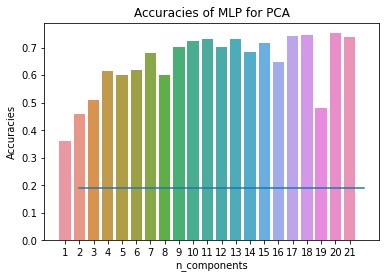

In [66]:
bar(acc_pca,avg_acc_base,"PCA")

In [67]:
acc_pca

[0.3600713012477718,
 0.45811051693404636,
 0.5115864527629234,
 0.6149732620320856,
 0.6024955436720143,
 0.6185383244206774,
 0.6809269162210339,
 0.6024955436720143,
 0.7040998217468806,
 0.7237076648841355,
 0.732620320855615,
 0.7023172905525846,
 0.732620320855615,
 0.6827094474153298,
 0.7183600713012478,
 0.6488413547237076,
 0.7415329768270945,
 0.7468805704099821,
 0.48128342245989303,
 0.7522281639928698,
 0.7397504456327986]

In [68]:
np.argmax(acc_pca)

19

C:\Users\EGYPT_LAPTOP\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\EGYPT_LAPTOP\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
C:\Users\EGYPT_LAPTOP\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\EGYPT_LAPTOP\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
C:\Users\EGYPT_LAPTOP\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\EGYPT_LAPTOP\anaconda3\lib\site-packa

Text(0.5, 1.0, 'TSNE for validation set for PCA')

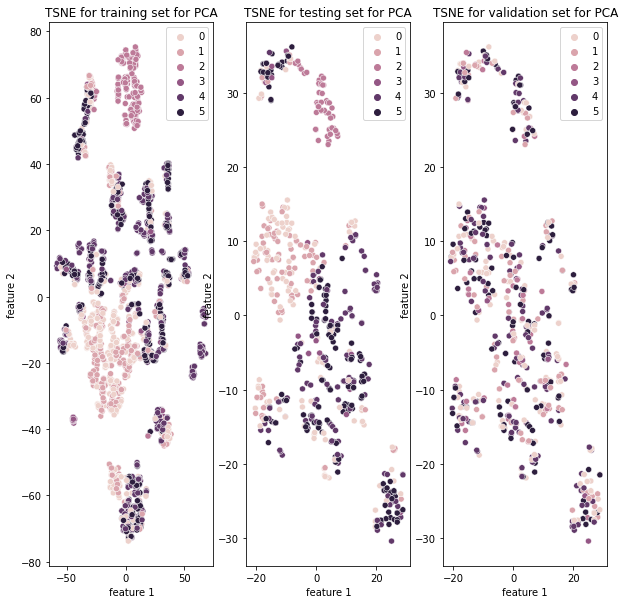

In [70]:
plt.figure(figsize=(10, 10))
plt.subplot(1,3,1)
train_tsne = tsne(x_train_pca,y_train)
plt.title("TSNE for training set for PCA")
plt.subplot(1,3,2)
train_tsne = tsne(x_test_pca,y_test)
plt.title("TSNE for testing set for PCA")
plt.subplot(1,3,3)
train_tsne = tsne(x_val_pca,y_val)
plt.title("TSNE for validation set for PCA")

# Feature selection

In [64]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import mutual_info_classif,f_classif
def selectkbest(model,k,x_train,y_train,x_val,x_test):
    select = SelectKBest(score_func= model,k = k)
    x_train_fs = select.fit_transform(x_train,y_train)
    x_val_fs = select.transform(x_val)
    x_test_fs = select.transform(x_test)
    x = train.iloc[:,:-1]
    features_names = select.get_feature_names_out(x.columns)
    return x_train_fs,x_test_fs,x_val_fs,features_names

In [72]:
acc_info = []

for i in range(1,22):
    y_pred_info = []
  #Mutual information
    x_train_info,x_test_info,x_val_info,features_names_info = selectkbest(mutual_info_classif,i,x_train,y_train,x_val,x_test)
    history_info,y_info = mlp(x_train_info,x_val_info,x_test_info,y_train,y_val,y_test,10,"relu",0.001,500,1)
    for i in range(len(y_info)):
        y_pred_info.append(np.argmax(y_info[i]))
    acc_info.append(accuracy_score(y_test,y_pred_info))

Epoch 1/500
2619/2619 [==============================] - 3s 910us/step - loss: 1.4939 - accuracy: 0.3669 - val_loss: 1.4183 - val_accuracy: 0.3672
Epoch 2/500
2619/2619 [==============================] - 2s 880us/step - loss: 1.3808 - accuracy: 0.3952 - val_loss: 1.3922 - val_accuracy: 0.4011
Epoch 3/500
2619/2619 [==============================] - 2s 892us/step - loss: 1.3687 - accuracy: 0.3944 - val_loss: 1.3883 - val_accuracy: 0.4510
Epoch 4/500
2619/2619 [==============================] - 2s 892us/step - loss: 1.3605 - accuracy: 0.4101 - val_loss: 1.3799 - val_accuracy: 0.4082
Epoch 5/500
2619/2619 [==============================] - 2s 901us/step - loss: 1.3586 - accuracy: 0.4223 - val_loss: 1.3779 - val_accuracy: 0.4011
Epoch 6/500
2619/2619 [==============================] - 2s 913us/step - loss: 1.3570 - accuracy: 0.4116 - val_loss: 1.3740 - val_accuracy: 0.4082
Epoch 7/500
2619/2619 [==============================] - 2s 920us/step - loss: 1.3548 - accuracy: 0.4234 - val_loss: 1

KeyboardInterrupt: 

In [40]:
acc_info

[0.21746880570409982,
 0.5258467023172906,
 0.3048128342245989,
 0.5775401069518716,
 0.7005347593582888,
 0.7040998217468806,
 0.5418894830659536,
 0.5490196078431373,
 0.5347593582887701,
 0.6024955436720143,
 0.6524064171122995,
 0.696969696969697,
 0.6221033868092691,
 0.7058823529411765,
 0.6809269162210339,
 0.47058823529411764,
 0.6844919786096256,
 0.6452762923351159,
 0.7468805704099821,
 0.7397504456327986,
 0.5561497326203209]

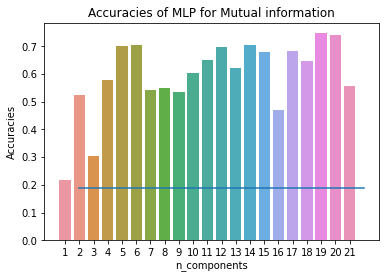

In [74]:
bar(acc_info,avg_acc_base,"Mutual information")

In [47]:
np.argmax(acc_info)

18

In [55]:
acc_anova = []

for i in range(1,22):
    y_pred_anova = []
    #f_classif
    x_train_anova,x_test_anova,x_val_anova,features_names_anova = selectkbest(f_classif,i,x_train,y_train,x_val,x_test)
    history_anova,y_anova = mlp(x_train_anova,x_val_anova,x_test_anova,y_train,y_val,y_test,10,"relu",0.001,500,1)
    for i in range(len(y_anova)):
        y_pred_anova.append(np.argmax(y_anova[i]))
    acc_anova.append(accuracy_score(y_test,y_pred_anova))  

Epoch 1/500
2619/2619 [==============================] - 3s 1ms/step - loss: 1.7580 - accuracy: 0.2906 - val_loss: 1.7105 - val_accuracy: 0.3868
Epoch 2/500
2619/2619 [==============================] - 3s 1ms/step - loss: 1.7157 - accuracy: 0.2826 - val_loss: 1.6744 - val_accuracy: 0.3868
Epoch 3/500
2619/2619 [==============================] - 3s 979us/step - loss: 1.6937 - accuracy: 0.3112 - val_loss: 1.6629 - val_accuracy: 0.3868
Epoch 4/500
2619/2619 [==============================] - 3s 991us/step - loss: 1.6840 - accuracy: 0.3108 - val_loss: 1.6538 - val_accuracy: 0.2210
Epoch 5/500
2619/2619 [==============================] - 3s 1ms/step - loss: 1.6773 - accuracy: 0.2997 - val_loss: 1.6459 - val_accuracy: 0.3298
Epoch 6/500
2619/2619 [==============================] - 3s 1ms/step - loss: 1.6711 - accuracy: 0.3020 - val_loss: 1.6412 - val_accuracy: 0.3868
Epoch 7/500
2619/2619 [==============================] - 3s 1ms/step - loss: 1.6684 - accuracy: 0.3074 - val_loss: 1.6358 - va

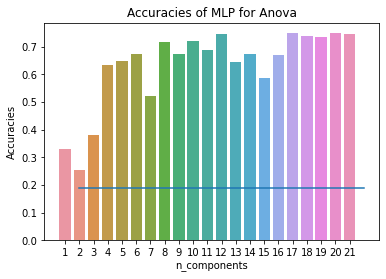

In [73]:
bar(acc_anova,avg_acc_base,"Anova")

In [57]:
acc_anova

[0.32976827094474154,
 0.2549019607843137,
 0.37967914438502676,
 0.6345811051693404,
 0.6488413547237076,
 0.6755793226381461,
 0.5222816399286988,
 0.7165775401069518,
 0.6755793226381461,
 0.7219251336898396,
 0.6898395721925134,
 0.7450980392156863,
 0.6452762923351159,
 0.6755793226381461,
 0.5882352941176471,
 0.6720142602495544,
 0.7486631016042781,
 0.7379679144385026,
 0.7361853832442068,
 0.7486631016042781,
 0.7450980392156863]

In [48]:
np.argmax(acc_anova)

16

# Anova is better than mutual information 

C:\Users\EGYPT_LAPTOP\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\EGYPT_LAPTOP\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
C:\Users\EGYPT_LAPTOP\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\EGYPT_LAPTOP\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(
C:\Users\EGYPT_LAPTOP\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\EGYPT_LAPTOP\anaconda3\lib\site-packa

Text(0.5, 1.0, 'TSNE for validation set for Anova')

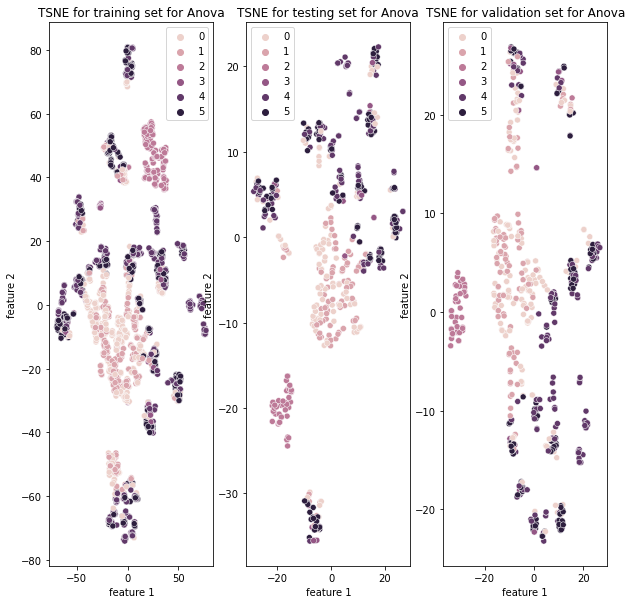

In [84]:
plt.figure(figsize=(10, 10))
plt.subplot(1,3,1)
train_tsne = tsne(x_train_anova,y_train)
plt.title("TSNE for training set for Anova")
plt.subplot(1,3,2)
train_tsne = tsne(x_test_anova,y_test)
plt.title("TSNE for testing set for Anova")
plt.subplot(1,3,3)
train_tsne = tsne(x_val_anova,y_val)
plt.title("TSNE for validation set for Anova")

# choose the best Anova or PCA

## Anova

In [ ]:
def mlp(x1,x2,x3,y1,y2,y3,neurons,active,lr,epochs,batch_size):
    model = Sequential()
    model.add(Dense(neurons,input_dim = x1.shape[1]))
    model.add(Activation(active))
    model.add(Dense(6))
    model.add(Activation(active))
    optimizer = tfa.optimizers.AdamW(learning_rate = lr, weight_decay = 0.0001)
    model.compile(loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True), optimizer =optimizer, metrics = ['accuracy'])
    filepath="best_model.hdf5"
    checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy',verbose=1,save_best_only=True, mode='max')
    history = model.fit(x1,y1,validation_data = [x2,y2], epochs = epochs,batch_size = batch_size, verbose = True, callbacks=[checkpoint])
    y_pred = model.predict(x3)
    return history,y_pred,model,filepath

In [74]:
x_train_anova,x_test_anova,x_val_anova,features_names_anova = selectkbest(f_classif,17,x_train,y_train,x_val,x_test)
history_anova,y_anova,model,filepath = mlp(x_train_anova,x_test_anova,x_val_anova,y_train,y_test,y_val,10,"relu",0.001,500,1)
for i in range(len(y_anova)):
    y_pred_anova.append(np.argmax(y_anova[i]))
acc_anova = accuracy_score(y_test,y_pred_anova)

Epoch 1/500
2568/2619 [============================>.] - ETA: 0s - loss: 1.5131 - accuracy: 0.3540
Epoch 1: val_accuracy improved from -inf to 0.49198, saving model to best_model.hdf5
2619/2619 [==============================] - 3s 1ms/step - loss: 1.5127 - accuracy: 0.3574 - val_loss: 1.3562 - val_accuracy: 0.4920
Epoch 2/500
2585/2619 [============================>.] - ETA: 0s - loss: 1.2260 - accuracy: 0.5559
Epoch 2: val_accuracy improved from 0.49198 to 0.60428, saving model to best_model.hdf5
2619/2619 [==============================] - 3s 1ms/step - loss: 1.2245 - accuracy: 0.5563 - val_loss: 1.1749 - val_accuracy: 0.6043
Epoch 3/500
2569/2619 [============================>.] - ETA: 0s - loss: 1.1451 - accuracy: 0.5870
Epoch 3: val_accuracy improved from 0.60428 to 0.62032, saving model to best_model.hdf5
2619/2619 [==============================] - 3s 1ms/step - loss: 1.1419 - accuracy: 0.5880 - val_loss: 0.9942 - val_accuracy: 0.6203
Epoch 4/500
2586/2619 [====================

ValueError: Found input variables with inconsistent numbers of samples: [561, 1122]

In [75]:
acc_anova

0.19073083778966132

In [76]:
features_names_anova

array(['Port Number', 'Received Packets', 'Received Bytes', 'Sent Bytes',
       'Sent Packets', 'Port alive Duration (S)',
       'Delta Received Packets', 'Delta Sent Packets',
       'Delta Port alive Duration (S)', 'Connection Point',
       'Total Load/Latest', 'Unknown Load/Rate', 'Unknown Load/Latest',
       'Latest bytes counter', 'Active Flow Entries', 'Packets Looked Up',
       'Packets Matched'], dtype=object)

## PCA

In [71]:
y_pred_pca = []
x_train_pca,x_test_pca,x_val_pca = pca(20,x_train,x_test,x_val)
history_pca,y_pca,model,filepath = mlp(x_train_pca,x_test_pca,x_val_pca,y_train,y_test,y_val,10,"relu",0.001,500,1)
for i in range(len(y_pca)):
    y_pred_pca.append(np.argmax(y_pca[i]))
acc_pca = accuracy_score(y_test,y_pred_pca)

Epoch 1/500
2608/2619 [============================>.] - ETA: 0s - loss: 1.4351 - accuracy: 0.4540
Epoch 1: val_accuracy improved from -inf to 0.52050, saving model to best_model.hdf5
2619/2619 [==============================] - 3s 1ms/step - loss: 1.4331 - accuracy: 0.4544 - val_loss: 1.0801 - val_accuracy: 0.5205
Epoch 2/500
2591/2619 [============================>.] - ETA: 0s - loss: 0.9084 - accuracy: 0.6148
Epoch 2: val_accuracy improved from 0.52050 to 0.65241, saving model to best_model.hdf5
2619/2619 [==============================] - 3s 962us/step - loss: 0.9083 - accuracy: 0.6147 - val_loss: 0.8066 - val_accuracy: 0.6524
Epoch 3/500
2600/2619 [============================>.] - ETA: 0s - loss: 0.7880 - accuracy: 0.6746
Epoch 3: val_accuracy improved from 0.65241 to 0.67558, saving model to best_model.hdf5
2619/2619 [==============================] - 3s 985us/step - loss: 0.7895 - accuracy: 0.6739 - val_loss: 0.7642 - val_accuracy: 0.6756
Epoch 4/500
2567/2619 [================

In [72]:
acc_pca

0.7522281639928698

# Updating the datasets

In [36]:
x_train_new, x_test_new,x_val_new = pca(20,x_train,x_test,x_val)
print(x_train_new)
print(x_test_new)
print(x_val_new)

[[-1.36571471e+00  4.58298872e-01  3.56497553e-01 ...  8.07320657e-05
   8.56119817e-16  4.01997530e-16]
 [-1.40457055e+00  4.46376366e-01  4.10849115e-01 ... -5.84629279e-06
  -1.14080457e-15 -1.68385272e-16]
 [ 4.15217108e+00 -3.90084529e+00  1.10660322e+00 ... -5.77944450e-05
   1.19995752e-15  6.39730703e-16]
 ...
 [-1.24365308e+00  2.53123311e-01  4.18614762e-01 ... -8.21046471e-06
  -5.83103001e-18 -2.64095176e-17]
 [ 5.73744412e+00  8.90296641e+00  1.52506563e-01 ... -2.95335701e-05
   5.68664364e-17  6.97574077e-16]
 [-1.19976586e+00  2.96128257e-01  3.22370049e-02 ...  6.05421531e-05
  -4.26751975e-17  7.16106391e-18]]
[[-1.29563224e+00  3.37827174e-01  3.76296730e-01 ...  5.57348558e-05
  -5.31587953e-16 -4.66586636e-17]
 [ 3.51850677e+00 -3.51826535e+00  1.85926199e+00 ... -1.23177154e-05
  -2.80650857e-16 -2.13850537e-16]
 [-1.36388594e+00  3.97546110e-01  2.88176218e-01 ...  3.52217679e-05
   1.08386943e-16  1.47163679e-16]
 ...
 [-1.25876038e+00  3.55084559e-01  3.6328173

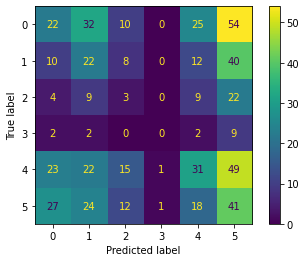

In [80]:
cm = confusion_matrix(y_val,y_pred_pca)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()

# Batch size	

In [82]:
acc_avg = []
acc_32 = []
train_acc_32 = []
test_acc_32 = []
val_acc_32 = []

for i in range(5):
    history_32, y_pred_32, m_32,filepath = mlp(x_train_new,x_val_new,x_test_new,y_train,y_val,y_test,10,"relu",0.001,500,32)
    m_32.load_weights(filepath)
    train_acc_32.append(m_32.evaluate(x_train_new, y_train)[1])
    test_acc_32.append(m_32.evaluate(x_test_new, y_test)[1])
    val_acc_32.append(m_32.evaluate(x_val_new, y_val)[1])
    y_pred_batch = []
    for j in range(len(y_pred_32)):
        y_pred_batch.append(np.argmax(y_pred_32[j]))
    acc_32.append(accuracy_score(y_test,y_pred_batch))
acc_avg.append(np.mean(acc_32))

Epoch 1/500
65/82 [======================>.......] - ETA: 0s - loss: 1.8148 - accuracy: 0.2115
Epoch 1: val_accuracy improved from -inf to 0.19073, saving model to best_model.hdf5
82/82 [==============================] - 1s 5ms/step - loss: 1.7959 - accuracy: 0.2222 - val_loss: 1.8049 - val_accuracy: 0.1907
Epoch 2/500
46/82 [===============>..............] - ETA: 0s - loss: 1.6490 - accuracy: 0.3424
Epoch 2: val_accuracy did not improve from 0.19073
82/82 [==============================] - 0s 2ms/step - loss: 1.6051 - accuracy: 0.3708 - val_loss: 1.8398 - val_accuracy: 0.1693
Epoch 3/500
70/82 [========================>.....] - ETA: 0s - loss: 1.4452 - accuracy: 0.4531
Epoch 3: val_accuracy improved from 0.19073 to 0.19964, saving model to best_model.hdf5
82/82 [==============================] - 0s 2ms/step - loss: 1.4313 - accuracy: 0.4612 - val_loss: 1.9046 - val_accuracy: 0.1996
Epoch 4/500
49/82 [================>.............] - ETA: 0s - loss: 1.2856 - accuracy: 0.5281
Epoch 4: 

In [83]:
train_acc_32

[0.750286340713501,
 0.733867883682251,
 0.4184803366661072,
 0.5452463030815125,
 0.5903016328811646]

In [84]:
table(train_acc_32,test_acc_32,val_acc_32)

Min training acc:  0.4184803366661072
Max training acc:  0.750286340713501
Avg training acc:  0.6076364994049073
Min testing acc:  0.4064171016216278
Max testing acc:  0.7504456043243408
Avg testing acc:  0.5864527583122253
Min validation acc:  0.21746881306171417
Max validation acc:  0.2442067712545395
Avg validation acc:  0.23315508365631105


In [85]:
acc_64 = []
train_acc_64 = []
test_acc_64 = []
val_acc_64 = []
for i in range(5):
    history_64, y_pred_64,m_64,filepath = mlp(x_train_new,x_val_new,x_test_new,y_train,y_val,y_test,10,"relu",0.001,500,64)
    y_pred_batch = []
    for j in range(len(y_pred_64)):
        y_pred_batch.append(np.argmax(y_pred_64[j]))
    acc_64.append(accuracy_score(y_test,y_pred_batch))
    m_64.load_weights(filepath)
    train_acc_64.append(m_64.evaluate(x_train_new, y_train)[1])
    test_acc_64.append(m_64.evaluate(x_test_new, y_test)[1])
    val_acc_64.append(m_64.evaluate(x_val_new, y_val)[1])
acc_avg.append(np.mean(acc_64))

Epoch 1/500
30/41 [====================>.........] - ETA: 0s - loss: 1.7943 - accuracy: 0.2969 
Epoch 1: val_accuracy improved from -inf to 0.20143, saving model to best_model.hdf5
41/41 [==============================] - 1s 9ms/step - loss: 1.7835 - accuracy: 0.2990 - val_loss: 1.8519 - val_accuracy: 0.2014
Epoch 2/500
 1/41 [..............................] - ETA: 0s - loss: 1.7656 - accuracy: 0.3438
Epoch 2: val_accuracy improved from 0.20143 to 0.20677, saving model to best_model.hdf5
41/41 [==============================] - 0s 2ms/step - loss: 1.6649 - accuracy: 0.3417 - val_loss: 1.8323 - val_accuracy: 0.2068
Epoch 3/500
 1/41 [..............................] - ETA: 0s - loss: 1.6032 - accuracy: 0.3125
Epoch 3: val_accuracy improved from 0.20677 to 0.21212, saving model to best_model.hdf5
41/41 [==============================] - 0s 2ms/step - loss: 1.5558 - accuracy: 0.4212 - val_loss: 1.8278 - val_accuracy: 0.2121
Epoch 4/500
40/41 [============================>.] - ETA: 0s - los

In [86]:
table(train_acc_64,test_acc_64,val_acc_64)

Min training acc:  0.2516227662563324
Max training acc:  0.6754486560821533
Avg training acc:  0.5279877960681916
Min testing acc:  0.2655971348285675
Max testing acc:  0.6898396015167236
Avg testing acc:  0.5354723751544952
Min validation acc:  0.2245989292860031
Max validation acc:  0.25311943888664246
Avg validation acc:  0.239215686917305


In [88]:
acc_128 = []
train_acc_128 = []
test_acc_128 = []
val_acc_128 = []
for i in range(5):
    history_128, y_pred_128,m_128,filepath = mlp(x_train_new,x_val_new,x_test_new,y_train,y_val,y_test,10,"relu",0.001,500,128)
    y_pred_batch = []
    for j in range(len(y_pred_128)):
        y_pred_batch.append(np.argmax(y_pred_128[j]))
    acc_128.append(accuracy_score(y_test,y_pred_batch))
    m_128.load_weights(filepath)
    train_acc_128.append(m_128.evaluate(x_train_new, y_train)[1])
    test_acc_128.append(m_128.evaluate(x_test_new, y_test)[1])
    val_acc_128.append(m_128.evaluate(x_val_new, y_val)[1])
acc_avg.append(np.mean(acc_128))

Epoch 1/500
 1/21 [>.............................] - ETA: 11s - loss: 1.8503 - accuracy: 0.1953
Epoch 1: val_accuracy improved from -inf to 0.25490, saving model to best_model.hdf5
21/21 [==============================] - 1s 19ms/step - loss: 1.8568 - accuracy: 0.2421 - val_loss: 1.8204 - val_accuracy: 0.2549
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.8465 - accuracy: 0.2891
Epoch 2: val_accuracy did not improve from 0.25490
21/21 [==============================] - 0s 3ms/step - loss: 1.7901 - accuracy: 0.2688 - val_loss: 1.8016 - val_accuracy: 0.2513
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.8765 - accuracy: 0.2500
Epoch 3: val_accuracy did not improve from 0.25490
21/21 [==============================] - 0s 3ms/step - loss: 1.7337 - accuracy: 0.2944 - val_loss: 1.7898 - val_accuracy: 0.2513
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.6295 - accuracy: 0.3828
Epoch 4: val_accuracy improved from 0.25490 

In [89]:
table(train_acc_128,test_acc_128,val_acc_128)

Min training acc:  0.2760595679283142
Max training acc:  0.6120656728744507
Avg training acc:  0.44116075038909913
Min testing acc:  0.3030303120613098
Max testing acc:  0.6310160160064697
Avg testing acc:  0.43315507769584655
Min validation acc:  0.23351158201694489
Max validation acc:  0.25846701860427856
Avg validation acc:  0.24456327855587007


In [90]:
print(np.mean(val_acc_32))
print(np.mean(val_acc_64))
print(np.mean(val_acc_128))

0.23315508365631105
0.239215686917305
0.24456327855587007


# Hidden layers

## 1 Hidden layer

In [70]:
def one_hidden(i):
    model = Sequential()
    model.add(Dense(i,input_dim = x_train_new.shape[1]))
    model.add(Activation("relu"))
    model.add(Dense(6))
    model.add(Activation("relu"))
    optimizer = tfa.optimizers.AdamW(learning_rate = 0.001, weight_decay = 0.0001)
    model.compile(loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True), optimizer =optimizer, metrics = ['accuracy'])
    filepath="best_model.hdf5"
    checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy',verbose=1,save_best_only=True, mode='max')
    history = model.fit(x_train_new,y_train,validation_data = [x_val_new,y_val], epochs = 500,batch_size = 128, verbose = True, callbacks=[checkpoint])
    y_pred = model.predict(x_test_new)
    
    y_pred_baseline = []
    for i in range(len(y_pred)):
        y_pred_baseline.append(np.argmax(y_pred[i]))
    acc = accuracy_score(y_test,y_pred_baseline)
    return acc,model,filepath

In [71]:
train_acc_10 = []
test_acc_10 = []
val_acc_10 = []

for i in range(5):
    acc_10,model_10,filepath = one_hidden(10)
    model_10.load_weights(filepath)
    train_acc_10.append(model_10.evaluate(x_train_new, y_train)[1])
    test_acc_10.append(model_10.evaluate(x_test_new, y_test)[1])
    val_acc_10.append(model_10.evaluate(x_val_new, y_val)[1])

Epoch 1/500
 1/21 [>.............................] - ETA: 6s - loss: 1.9560 - accuracy: 0.1484
Epoch 1: val_accuracy improved from -inf to 0.22282, saving model to best_model.hdf5
21/21 [==============================] - 1s 9ms/step - loss: 1.8971 - accuracy: 0.2108 - val_loss: 1.8375 - val_accuracy: 0.2228
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.8355 - accuracy: 0.2578
Epoch 2: val_accuracy improved from 0.22282 to 0.23529, saving model to best_model.hdf5
21/21 [==============================] - 0s 3ms/step - loss: 1.8375 - accuracy: 0.2608 - val_loss: 1.8238 - val_accuracy: 0.2353
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7992 - accuracy: 0.3125
Epoch 3: val_accuracy did not improve from 0.23529
21/21 [==============================] - 0s 2ms/step - loss: 1.7892 - accuracy: 0.2997 - val_loss: 1.8163 - val_accuracy: 0.2299
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7830 - accuracy: 0.3281
Epoch 4: 

In [72]:
print(acc_10)
table(train_acc_10,test_acc_10,val_acc_10)

0.7843137254901961
Min training acc:  0.36807942390441895
Max training acc:  0.6429935097694397
Avg training acc:  0.5407407402992248
Min testing acc:  0.33155080676078796
Max testing acc:  0.6648841500282288
Avg testing acc:  0.5383244216442108
Min validation acc:  0.20499108731746674
Max validation acc:  0.24242424964904785
Avg validation acc:  0.23208556473255157


In [73]:
train_acc_20 = []
test_acc_20 = []
val_acc_20 = []

for i in range(5):
    acc_20,model_20,filepath = one_hidden(20)
    model_20.load_weights(filepath)
    train_acc_20.append(model_20.evaluate(x_train_new, y_train)[1])
    test_acc_20.append(model_20.evaluate(x_test_new, y_test)[1])
    val_acc_20.append(model_20.evaluate(x_val_new, y_val)[1])

Epoch 1/500
 1/21 [>.............................] - ETA: 8s - loss: 1.8917 - accuracy: 0.1797
Epoch 1: val_accuracy improved from -inf to 0.17469, saving model to best_model.hdf5
21/21 [==============================] - 1s 12ms/step - loss: 1.9469 - accuracy: 0.1898 - val_loss: 1.9419 - val_accuracy: 0.1747
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.9266 - accuracy: 0.2344
Epoch 2: val_accuracy improved from 0.17469 to 0.18717, saving model to best_model.hdf5
21/21 [==============================] - 0s 3ms/step - loss: 1.8180 - accuracy: 0.2593 - val_loss: 1.9174 - val_accuracy: 0.1872
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.6852 - accuracy: 0.3359
Epoch 3: val_accuracy did not improve from 0.18717
21/21 [==============================] - 0s 2ms/step - loss: 1.7207 - accuracy: 0.3028 - val_loss: 1.9168 - val_accuracy: 0.1836
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.6762 - accuracy: 0.3438
Epoch 4:

In [74]:
print(acc_20)
table(train_acc_20,test_acc_20,val_acc_20)

0.7967914438502673
Min training acc:  0.43337151408195496
Max training acc:  0.5708285570144653
Avg training acc:  0.5011836528778076
Min testing acc:  0.4117647111415863
Max testing acc:  0.5846702456474304
Avg testing acc:  0.4955436706542969
Min validation acc:  0.2245989292860031
Max validation acc:  0.2655971348285675
Avg validation acc:  0.2399286985397339


In [75]:
train_acc_30 = []
test_acc_30 = []
val_acc_30 = []

for i in range(5):
    acc_30,model_30,filepath = one_hidden(30)
    model_30.load_weights(filepath)
    train_acc_30.append(model_30.evaluate(x_train_new, y_train)[1])
    test_acc_30.append(model_30.evaluate(x_test_new, y_test)[1])
    val_acc_30.append(model_30.evaluate(x_val_new, y_val)[1])

Epoch 1/500
 1/21 [>.............................] - ETA: 7s - loss: 1.8883 - accuracy: 0.1406
Epoch 1: val_accuracy improved from -inf to 0.21034, saving model to best_model.hdf5
21/21 [==============================] - 1s 10ms/step - loss: 1.8184 - accuracy: 0.2058 - val_loss: 1.8043 - val_accuracy: 0.2103
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7746 - accuracy: 0.2031
Epoch 2: val_accuracy improved from 0.21034 to 0.21925, saving model to best_model.hdf5
21/21 [==============================] - 0s 3ms/step - loss: 1.7161 - accuracy: 0.2906 - val_loss: 1.7952 - val_accuracy: 0.2193
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.6697 - accuracy: 0.3359
Epoch 3: val_accuracy did not improve from 0.21925
21/21 [==============================] - 0s 2ms/step - loss: 1.6242 - accuracy: 0.3719 - val_loss: 1.7941 - val_accuracy: 0.2139
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.5768 - accuracy: 0.4062
Epoch 4:

In [76]:
print(acc_30)
table(train_acc_30,test_acc_30,val_acc_30)

0.7825311942959001
Min training acc:  0.5242459177970886
Max training acc:  0.7472317814826965
Avg training acc:  0.6420007705688476
Min testing acc:  0.5454545617103577
Max testing acc:  0.7540106773376465
Avg testing acc:  0.6417112231254578
Min validation acc:  0.22281639277935028
Max validation acc:  0.2495543658733368
Avg validation acc:  0.23672014176845552


In [77]:
train_acc_40 = []
test_acc_40 = []
val_acc_40 = []

for i in range(5):
    acc_40,model_40,filepath = one_hidden(40)
    model_40.load_weights(filepath)
    train_acc_40.append(model_40.evaluate(x_train_new, y_train)[1])
    test_acc_40.append(model_40.evaluate(x_test_new, y_test)[1])
    val_acc_40.append(model_40.evaluate(x_val_new, y_val)[1])

Epoch 1/500
 1/21 [>.............................] - ETA: 13s - loss: 1.9026 - accuracy: 0.1484
Epoch 1: val_accuracy improved from -inf to 0.20856, saving model to best_model.hdf5
21/21 [==============================] - 1s 9ms/step - loss: 1.8103 - accuracy: 0.2188 - val_loss: 1.8346 - val_accuracy: 0.2086
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7116 - accuracy: 0.3203
Epoch 2: val_accuracy did not improve from 0.20856
21/21 [==============================] - 0s 2ms/step - loss: 1.6321 - accuracy: 0.3593 - val_loss: 1.8548 - val_accuracy: 0.2032
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.6130 - accuracy: 0.4141
Epoch 3: val_accuracy did not improve from 0.20856
21/21 [==============================] - 0s 2ms/step - loss: 1.4991 - accuracy: 0.4498 - val_loss: 1.8908 - val_accuracy: 0.2086
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.4313 - accuracy: 0.4609
Epoch 4: val_accuracy improved from 0.20856 t

In [78]:
print(acc_40)
table(train_acc_40,test_acc_40,val_acc_40)

0.7843137254901961
Min training acc:  0.6300114393234253
Max training acc:  0.7537227869033813
Avg training acc:  0.6823978662490845
Min testing acc:  0.6310160160064697
Max testing acc:  0.7361853718757629
Avg testing acc:  0.6866310119628907
Min validation acc:  0.2085561454296112
Max validation acc:  0.22994652390480042
Avg validation acc:  0.2196078419685364


In [79]:
print(np.mean(val_acc_10))
print(np.mean(val_acc_20))
print(np.mean(val_acc_30))
print(np.mean(val_acc_40))

0.23208556473255157
0.2399286985397339
0.23672014176845552
0.2196078419685364


## 2 Hidden layers

In [80]:
def two_hidden(i):
    model = Sequential()
    model.add(Dense(i,input_dim = x_train_new.shape[1]))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(6))
    model.add(Activation("relu"))
    optimizer = tfa.optimizers.AdamW(learning_rate = 0.001, weight_decay = 0.0001)
    model.compile(loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True), optimizer =optimizer, metrics = ['accuracy'])
    filepath="best_model.hdf5"
    checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy',verbose=1,save_best_only=True, mode='max')
    history = model.fit(x_train_new,y_train,validation_data = [x_val_new,y_val], epochs = 500,batch_size = 128, verbose = True, callbacks=[checkpoint])
    y_pred = model.predict(x_test_new)
    y_pred_baseline = []
    for i in range(len(y_pred)):
        y_pred_baseline.append(np.argmax(y_pred[i]))
    acc = accuracy_score(y_test,y_pred_baseline)
    return acc,model,filepath

In [81]:
train_acc_10_2 = []
test_acc_10_2 = []
val_acc_10_2 = []

for i in range(5):
    acc_10_2,model_10_2,filepath = two_hidden(10)
    model_10_2.load_weights(filepath)
    train_acc_10_2.append(model_10_2.evaluate(x_train_new, y_train)[1])
    test_acc_10_2.append(model_10_2.evaluate(x_test_new, y_test)[1])
    val_acc_10_2.append(model_10_2.evaluate(x_val_new, y_val)[1])

Epoch 1/500
 1/21 [>.............................] - ETA: 8s - loss: 1.8747 - accuracy: 0.2031
Epoch 1: val_accuracy improved from -inf to 0.24242, saving model to best_model.hdf5
21/21 [==============================] - 1s 9ms/step - loss: 1.8403 - accuracy: 0.1947 - val_loss: 1.7802 - val_accuracy: 0.2424
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7898 - accuracy: 0.2188
Epoch 2: val_accuracy improved from 0.24242 to 0.24955, saving model to best_model.hdf5
21/21 [==============================] - 0s 3ms/step - loss: 1.7825 - accuracy: 0.2482 - val_loss: 1.7651 - val_accuracy: 0.2496
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7742 - accuracy: 0.2656
Epoch 3: val_accuracy did not improve from 0.24955
21/21 [==============================] - 0s 2ms/step - loss: 1.7343 - accuracy: 0.2902 - val_loss: 1.7579 - val_accuracy: 0.2496
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7376 - accuracy: 0.2422
Epoch 4: 

In [82]:
print(acc_10_2)
table(train_acc_10_2,test_acc_10_2,val_acc_10_2)

0.7040998217468806
Min training acc:  0.31920579075813293
Max training acc:  0.7556319236755371
Avg training acc:  0.47949599027633666
Min testing acc:  0.2798573970794678
Max testing acc:  0.759358286857605
Avg testing acc:  0.480926913022995
Min validation acc:  0.2245989292860031
Max validation acc:  0.25846701860427856
Avg validation acc:  0.24385026693344117


In [83]:
train_acc_20_2 = []
test_acc_20_2 = []
val_acc_20_2 = []

for i in range(5):
    acc_20_2,model_20_2,filepath = two_hidden(20)
    model_20_2.load_weights(filepath)
    train_acc_20_2.append(model_20_2.evaluate(x_train_new, y_train)[1])
    test_acc_20_2.append(model_20_2.evaluate(x_test_new, y_test)[1])
    val_acc_20_2.append(model_20_2.evaluate(x_val_new, y_val)[1])

Epoch 1/500
 1/21 [>.............................] - ETA: 15s - loss: 1.9623 - accuracy: 0.1562
Epoch 1: val_accuracy improved from -inf to 0.24242, saving model to best_model.hdf5
21/21 [==============================] - 1s 9ms/step - loss: 1.8549 - accuracy: 0.2119 - val_loss: 1.7931 - val_accuracy: 0.2424
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7987 - accuracy: 0.2578
Epoch 2: val_accuracy did not improve from 0.24242
21/21 [==============================] - 0s 2ms/step - loss: 1.7560 - accuracy: 0.2814 - val_loss: 1.7717 - val_accuracy: 0.2282
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7033 - accuracy: 0.3438
Epoch 3: val_accuracy did not improve from 0.24242
21/21 [==============================] - 0s 2ms/step - loss: 1.6823 - accuracy: 0.3566 - val_loss: 1.7704 - val_accuracy: 0.2406
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.6578 - accuracy: 0.3828
Epoch 4: val_accuracy did not improve from 0.

In [84]:
print(acc_20_2)
table(train_acc_20_2,test_acc_20_2,val_acc_20_2)

0.7896613190730838
Min training acc:  0.2394043505191803
Max training acc:  0.7178312540054321
Avg training acc:  0.42153494358062743
Min testing acc:  0.21746881306171417
Max testing acc:  0.7112299203872681
Avg testing acc:  0.40677361786365507
Min validation acc:  0.22638146579265594
Max validation acc:  0.24242424964904785
Avg validation acc:  0.23493761122226714


In [85]:
train_acc_30_2 = []
test_acc_30_2 = []
val_acc_30_2 = []

for i in range(5):
    acc_30_2,model_30_2,filepath = two_hidden(30)
    model_30_2.load_weights(filepath)
    train_acc_30_2.append(model_30_2.evaluate(x_train_new, y_train)[1])
    test_acc_30_2.append(model_30_2.evaluate(x_test_new, y_test)[1])
    val_acc_30_2.append(model_30_2.evaluate(x_val_new, y_val)[1])

Epoch 1/500
 1/21 [>.............................] - ETA: 8s - loss: 2.0669 - accuracy: 0.0703
Epoch 1: val_accuracy improved from -inf to 0.18895, saving model to best_model.hdf5
21/21 [==============================] - 1s 10ms/step - loss: 1.8703 - accuracy: 0.1390 - val_loss: 1.8029 - val_accuracy: 0.1889
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7664 - accuracy: 0.2500
Epoch 2: val_accuracy improved from 0.18895 to 0.19073, saving model to best_model.hdf5
21/21 [==============================] - 0s 3ms/step - loss: 1.7414 - accuracy: 0.3036 - val_loss: 1.7903 - val_accuracy: 0.1907
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.6668 - accuracy: 0.4062
Epoch 3: val_accuracy improved from 0.19073 to 0.19430, saving model to best_model.hdf5
21/21 [==============================] - 0s 3ms/step - loss: 1.6362 - accuracy: 0.4074 - val_loss: 1.8185 - val_accuracy: 0.1943
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - los

In [86]:
print(acc_30_2)
table(train_acc_30_2,test_acc_30_2,val_acc_30_2)

0.6755793226381461
Min training acc:  0.36464300751686096
Max training acc:  0.7728140354156494
Avg training acc:  0.651470023393631
Min testing acc:  0.3475935757160187
Max testing acc:  0.7682709693908691
Avg testing acc:  0.6392156898975372
Min validation acc:  0.21746881306171417
Max validation acc:  0.24777182936668396
Avg validation acc:  0.22745098173618317


In [87]:
train_acc_40_2 = []
test_acc_40_2 = []
val_acc_40_2 = []

for i in range(5):
    acc_40_2,model_40_2,filepath = two_hidden(40)
    model_40_2.load_weights(filepath)
    train_acc_40_2.append(model_40_2.evaluate(x_train_new, y_train)[1])
    test_acc_40_2.append(model_40_2.evaluate(x_test_new, y_test)[1])
    val_acc_40_2.append(model_40_2.evaluate(x_val_new, y_val)[1])

Epoch 1/500
 1/21 [>.............................] - ETA: 8s - loss: 1.7971 - accuracy: 0.3047
Epoch 1: val_accuracy improved from -inf to 0.21569, saving model to best_model.hdf5
21/21 [==============================] - 1s 28ms/step - loss: 1.6968 - accuracy: 0.3242 - val_loss: 1.8277 - val_accuracy: 0.2157
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.5294 - accuracy: 0.4766
Epoch 2: val_accuracy did not improve from 0.21569
21/21 [==============================] - 0s 2ms/step - loss: 1.4849 - accuracy: 0.4464 - val_loss: 1.9351 - val_accuracy: 0.2068
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.4257 - accuracy: 0.4453
Epoch 3: val_accuracy improved from 0.21569 to 0.21747, saving model to best_model.hdf5
21/21 [==============================] - 0s 3ms/step - loss: 1.3196 - accuracy: 0.5220 - val_loss: 2.0633 - val_accuracy: 0.2175
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.3477 - accuracy: 0.5547
Epoch 4:

In [88]:
print(acc_40_2)
table(train_acc_40_2,test_acc_40_2,val_acc_40_2)

0.803921568627451
Min training acc:  0.49217259883880615
Max training acc:  0.6101565361022949
Avg training acc:  0.5527300477027893
Min testing acc:  0.4634581208229065
Max testing acc:  0.6131907105445862
Avg testing acc:  0.5522281587123871
Min validation acc:  0.22638146579265594
Max validation acc:  0.25668448209762573
Avg validation acc:  0.23672014474868774


In [89]:
print(np.mean(val_acc_10_2))
print(np.mean(val_acc_20_2))
print(np.mean(val_acc_30_2))
print(np.mean(val_acc_40_2))

0.24385026693344117
0.23493761122226714
0.22745098173618317
0.23672014474868774


## 4 Hidden layers

In [90]:
def four_hidden(i):
    model = Sequential()
    model.add(Dense(i,input_dim = x_train_new.shape[1]))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(6))
    model.add(Activation("relu"))
    optimizer = tfa.optimizers.AdamW(learning_rate = 0.001, weight_decay = 0.0001)
    model.compile(loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True), optimizer =optimizer, metrics = ['accuracy'])
    filepath="best_model.hdf5"
    checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy',verbose=1,save_best_only=True, mode='max')
    history = model.fit(x_train_new,y_train,validation_data = [x_val_new,y_val], epochs = 500,batch_size = 128, verbose = True, callbacks=[checkpoint])
    y_pred = model.predict(x_test_new)
    y_pred_baseline = []
    for i in range(len(y_pred)):
        y_pred_baseline.append(np.argmax(y_pred[i]))
    acc = accuracy_score(y_test,y_pred_baseline)
    return acc,model,filepath


In [91]:
train_acc_10_4 = []
test_acc_10_4 = []
val_acc_10_4 = []

for i in range(5):
    acc_10_4,model_10_4,filepath = four_hidden(10)
    model_10_4.load_weights(filepath)
    train_acc_10_4.append(model_10_4.evaluate(x_train_new, y_train)[1])
    test_acc_10_4.append(model_10_4.evaluate(x_test_new, y_test)[1])
    val_acc_10_4.append(model_10_4.evaluate(x_val_new, y_val)[1])

Epoch 1/500
 1/21 [>.............................] - ETA: 9s - loss: 1.7765 - accuracy: 0.2812
Epoch 1: val_accuracy improved from -inf to 0.21569, saving model to best_model.hdf5
21/21 [==============================] - 1s 10ms/step - loss: 1.7599 - accuracy: 0.2684 - val_loss: 1.7829 - val_accuracy: 0.2157
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7122 - accuracy: 0.3125
Epoch 2: val_accuracy improved from 0.21569 to 0.21747, saving model to best_model.hdf5
21/21 [==============================] - 0s 3ms/step - loss: 1.7233 - accuracy: 0.2982 - val_loss: 1.7900 - val_accuracy: 0.2175
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7108 - accuracy: 0.3281
Epoch 3: val_accuracy did not improve from 0.21747
21/21 [==============================] - 0s 2ms/step - loss: 1.6840 - accuracy: 0.3257 - val_loss: 1.8038 - val_accuracy: 0.2139
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.6453 - accuracy: 0.3984
Epoch 4:

In [92]:
print(acc_10_4)
table(train_acc_10_4,test_acc_10_4,val_acc_10_4)

0.7985739750445633
Min training acc:  0.2982054352760315
Max training acc:  0.7132493257522583
Avg training acc:  0.5544100821018219
Min testing acc:  0.2798573970794678
Max testing acc:  0.6934046149253845
Avg testing acc:  0.5529411673545838
Min validation acc:  0.22281639277935028
Max validation acc:  0.25846701860427856
Avg validation acc:  0.23885917961597442


In [93]:
train_acc_20_4 = []
test_acc_20_4 = []
val_acc_20_4 = []

for i in range(5):
    acc_20_4,model_20_4,filepath = four_hidden(20)
    model_20_4.load_weights(filepath)
    train_acc_20_4.append(model_20_4.evaluate(x_train_new, y_train)[1])
    test_acc_20_4.append(model_20_4.evaluate(x_test_new, y_test)[1])
    val_acc_20_4.append(model_20_4.evaluate(x_val_new, y_val)[1])

Epoch 1/500
 1/21 [>.............................] - ETA: 13s - loss: 1.8218 - accuracy: 0.0625
Epoch 1: val_accuracy improved from -inf to 0.24955, saving model to best_model.hdf5
21/21 [==============================] - 2s 49ms/step - loss: 1.7829 - accuracy: 0.2176 - val_loss: 1.7697 - val_accuracy: 0.2496
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7446 - accuracy: 0.3125
Epoch 2: val_accuracy improved from 0.24955 to 0.25134, saving model to best_model.hdf5
21/21 [==============================] - 1s 29ms/step - loss: 1.7135 - accuracy: 0.3337 - val_loss: 1.7622 - val_accuracy: 0.2513
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.6552 - accuracy: 0.3672
Epoch 3: val_accuracy improved from 0.25134 to 0.25312, saving model to best_model.hdf5
21/21 [==============================] - 0s 22ms/step - loss: 1.6130 - accuracy: 0.3761 - val_loss: 1.7810 - val_accuracy: 0.2531
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - 

In [94]:
print(acc_20_4)
table(train_acc_20_4,test_acc_20_4,val_acc_20_4)

0.7950089126559715
Min training acc:  0.3088965117931366
Max training acc:  0.6632302403450012
Avg training acc:  0.49201985597610476
Min testing acc:  0.301247775554657
Max testing acc:  0.6720142364501953
Avg testing acc:  0.4798573851585388
Min validation acc:  0.2245989292860031
Max validation acc:  0.25311943888664246
Avg validation acc:  0.23957219421863557


In [95]:
train_acc_30_4 = []
test_acc_30_4 = []
val_acc_30_4 = []

for i in range(5):
    acc_30_4,model_30_4,filepath = four_hidden(30)
    model_30_4.load_weights(filepath)
    train_acc_30_4.append(model_30_4.evaluate(x_train_new, y_train)[1])
    test_acc_30_4.append(model_30_4.evaluate(x_test_new, y_test)[1])
    val_acc_30_4.append(model_30_4.evaluate(x_val_new, y_val)[1])

Epoch 1/500
 1/21 [>.............................] - ETA: 10s - loss: 1.7628 - accuracy: 0.1953
Epoch 1: val_accuracy improved from -inf to 0.20856, saving model to best_model.hdf5
21/21 [==============================] - 1s 11ms/step - loss: 1.6690 - accuracy: 0.3414 - val_loss: 1.7560 - val_accuracy: 0.2086
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.5449 - accuracy: 0.5312
Epoch 2: val_accuracy improved from 0.20856 to 0.22816, saving model to best_model.hdf5
21/21 [==============================] - 0s 4ms/step - loss: 1.4350 - accuracy: 0.4849 - val_loss: 1.8315 - val_accuracy: 0.2282
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.2775 - accuracy: 0.5703
Epoch 3: val_accuracy did not improve from 0.22816
21/21 [==============================] - 0s 3ms/step - loss: 1.1601 - accuracy: 0.5139 - val_loss: 2.1887 - val_accuracy: 0.2175
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.0819 - accuracy: 0.4453
Epoch 4

In [96]:
print(acc_30_4)
table(train_acc_30_4,test_acc_30_4,val_acc_30_4)

0.8253119429590018
Min training acc:  0.34020617604255676
Max training acc:  0.5097365379333496
Avg training acc:  0.4394043445587158
Min testing acc:  0.3172905445098877
Max testing acc:  0.5026738047599792
Avg testing acc:  0.41033868193626405
Min validation acc:  0.22816398739814758
Max validation acc:  0.26737967133522034
Avg validation acc:  0.24206773340702056


In [97]:
train_acc_40_4 = []
test_acc_40_4 = []
val_acc_40_4 = []

for i in range(5):
    acc_40_4,model_40_4,filepath = four_hidden(30)
    model_40_4.load_weights(filepath)
    train_acc_40_4.append(model_40_4.evaluate(x_train_new, y_train)[1])
    test_acc_40_4.append(model_40_4.evaluate(x_test_new, y_test)[1])
    val_acc_40_4.append(model_40_4.evaluate(x_val_new, y_val)[1])

Epoch 1/500
 1/21 [>.............................] - ETA: 10s - loss: 1.7759 - accuracy: 0.2500
Epoch 1: val_accuracy improved from -inf to 0.23351, saving model to best_model.hdf5
21/21 [==============================] - 1s 11ms/step - loss: 1.7424 - accuracy: 0.2722 - val_loss: 1.7736 - val_accuracy: 0.2335
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.6721 - accuracy: 0.3438
Epoch 2: val_accuracy improved from 0.23351 to 0.23886, saving model to best_model.hdf5
21/21 [==============================] - 0s 4ms/step - loss: 1.6085 - accuracy: 0.4307 - val_loss: 1.8423 - val_accuracy: 0.2389
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.5719 - accuracy: 0.3906
Epoch 3: val_accuracy improved from 0.23886 to 0.24064, saving model to best_model.hdf5
21/21 [==============================] - 0s 4ms/step - loss: 1.4302 - accuracy: 0.4815 - val_loss: 2.0753 - val_accuracy: 0.2406
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - lo

In [98]:
print(acc_40_4)
table(train_acc_40_4,test_acc_40_4,val_acc_40_4)

0.8003565062388592
Min training acc:  0.45704466104507446
Max training acc:  0.7426498532295227
Avg training acc:  0.5659411907196045
Min testing acc:  0.4260249435901642
Max testing acc:  0.698752224445343
Avg testing acc:  0.5465240597724914
Min validation acc:  0.2139037400484085
Max validation acc:  0.270944744348526
Avg validation acc:  0.2377896636724472


In [99]:
print(np.mean(val_acc_10_4))
print(np.mean(val_acc_20_4))
print(np.mean(val_acc_30_4))
print(np.mean(val_acc_40_4))

0.23885917961597442
0.23957219421863557
0.24206773340702056
0.2377896636724472


## 8 Hidden layers

In [59]:
def eight_hidden(i):
    model = Sequential()
    model.add(Dense(i,input_dim = x_train_new.shape[1]))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(6))
    model.add(Activation("relu"))
    optimizer = tfa.optimizers.AdamW(learning_rate = 0.001, weight_decay = 0.0001)
    model.compile(loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True), optimizer =optimizer, metrics = ['accuracy'])
    filepath="best_model.hdf5"
    checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy',verbose=1,save_best_only=True, mode='max')
    history = model.fit(x_train_new,y_train,validation_data = [x_val_new,y_val], epochs = 500,batch_size = 128, verbose = True, callbacks=[checkpoint])
    y_pred = model.predict(x_test_new)
    y_pred_baseline = []
    for i in range(len(y_pred)):
        y_pred_baseline.append(np.argmax(y_pred[i]))
    acc = accuracy_score(y_test,y_pred_baseline)
    return acc, model, filepath

In [60]:
train_acc_10_8 = []
test_acc_10_8 = []
val_acc_10_8 = []

for i in range(5):
    acc_10_8,model_10_8,filepath = eight_hidden(10)
    model_10_8.load_weights(filepath)
    train_acc_10_8.append(model_10_8.evaluate(x_train_new, y_train)[1])
    test_acc_10_8.append(model_10_8.evaluate(x_test_new, y_test)[1])
    val_acc_10_8.append(model_10_8.evaluate(x_val_new, y_val)[1])

Epoch 1/500
 1/21 [>.............................] - ETA: 11s - loss: 1.7937 - accuracy: 0.0938
Epoch 1: val_accuracy improved from -inf to 0.20677, saving model to best_model.hdf5
21/21 [==============================] - 1s 11ms/step - loss: 1.7840 - accuracy: 0.2570 - val_loss: 1.7833 - val_accuracy: 0.2068
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7699 - accuracy: 0.3047
Epoch 2: val_accuracy did not improve from 0.20677
21/21 [==============================] - 0s 2ms/step - loss: 1.7588 - accuracy: 0.2959 - val_loss: 1.7808 - val_accuracy: 0.1943
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7356 - accuracy: 0.3281
Epoch 3: val_accuracy did not improve from 0.20677
21/21 [==============================] - 0s 3ms/step - loss: 1.7044 - accuracy: 0.3307 - val_loss: 1.7948 - val_accuracy: 0.1783
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.6467 - accuracy: 0.4062
Epoch 4: val_accuracy did not improve from 0

In [61]:
print(acc_10_8)
table(train_acc_10_8,test_acc_10_8,val_acc_10_8)

0.5686274509803921
Min training acc:  0.21687667071819305
Max training acc:  0.6731576919555664
Avg training acc:  0.4222222238779068
Min testing acc:  0.2245989292860031
Max testing acc:  0.6773618459701538
Avg testing acc:  0.42067736089229585
Min validation acc:  0.21033868193626404
Max validation acc:  0.25311943888664246
Avg validation acc:  0.23351158797740937


In [62]:
train_acc_20_8 = []
test_acc_20_8 = []
val_acc_20_8 = []

for i in range(5):
    acc_20_8,model_20_8,filepath = eight_hidden(20)
    model_20_8.load_weights(filepath)
    train_acc_20_8.append(model_20_8.evaluate(x_train_new, y_train)[1])
    test_acc_20_8.append(model_20_8.evaluate(x_test_new, y_test)[1])
    val_acc_20_8.append(model_20_8.evaluate(x_val_new, y_val)[1])

Epoch 1/500
 1/21 [>.............................] - ETA: 16s - loss: 1.7851 - accuracy: 0.2656
Epoch 1: val_accuracy improved from -inf to 0.18538, saving model to best_model.hdf5
21/21 [==============================] - 1s 14ms/step - loss: 1.7690 - accuracy: 0.3028 - val_loss: 1.7827 - val_accuracy: 0.1854
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7198 - accuracy: 0.3672
Epoch 2: val_accuracy improved from 0.18538 to 0.21925, saving model to best_model.hdf5
21/21 [==============================] - 0s 5ms/step - loss: 1.6909 - accuracy: 0.3524 - val_loss: 1.7888 - val_accuracy: 0.2193
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.5631 - accuracy: 0.4453
Epoch 3: val_accuracy improved from 0.21925 to 0.22103, saving model to best_model.hdf5
21/21 [==============================] - 0s 5ms/step - loss: 1.5181 - accuracy: 0.4311 - val_loss: 1.9498 - val_accuracy: 0.2210
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - lo

In [63]:
print(acc_20_8)
table(train_acc_20_8,test_acc_20_8,val_acc_20_8)

0.6987522281639929
Min training acc:  0.21611301600933075
Max training acc:  0.6670485138893127
Avg training acc:  0.47392134368419647
Min testing acc:  0.22103387117385864
Max testing acc:  0.565062403678894
Avg testing acc:  0.44278075695037844
Min validation acc:  0.22103387117385864
Max validation acc:  0.25846701860427856
Avg validation acc:  0.24705882370471954


In [64]:
train_acc_30_8 = []
test_acc_30_8 = []
val_acc_30_8 = []

for i in range(5):
    acc_30_8,model_30_8,filepath = eight_hidden(30)
    model_30_8.load_weights(filepath)
    train_acc_30_8.append(model_30_8.evaluate(x_train_new, y_train)[1])
    test_acc_30_8.append(model_30_8.evaluate(x_test_new, y_test)[1])
    val_acc_30_8.append(model_30_8.evaluate(x_val_new, y_val)[1])

Epoch 1/500
 1/21 [>.............................] - ETA: 13s - loss: 1.7929 - accuracy: 0.2422
Epoch 1: val_accuracy improved from -inf to 0.21747, saving model to best_model.hdf5
21/21 [==============================] - 1s 12ms/step - loss: 1.7532 - accuracy: 0.2585 - val_loss: 1.7923 - val_accuracy: 0.2175
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.6676 - accuracy: 0.3281
Epoch 2: val_accuracy improved from 0.21747 to 0.22816, saving model to best_model.hdf5
21/21 [==============================] - 0s 4ms/step - loss: 1.6130 - accuracy: 0.3036 - val_loss: 1.9270 - val_accuracy: 0.2282
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.4956 - accuracy: 0.3047
Epoch 3: val_accuracy improved from 0.22816 to 0.24955, saving model to best_model.hdf5
21/21 [==============================] - 0s 4ms/step - loss: 1.4540 - accuracy: 0.4105 - val_loss: 2.0978 - val_accuracy: 0.2496
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - lo

In [65]:
print(acc_30_8)
table(train_acc_30_8,test_acc_30_8,val_acc_30_8)

0.6381461675579323
Min training acc:  0.39900726079940796
Max training acc:  0.665139377117157
Avg training acc:  0.5347079038619995
Min testing acc:  0.40819963812828064
Max testing acc:  0.5935828685760498
Avg testing acc:  0.5083778858184814
Min validation acc:  0.21568627655506134
Max validation acc:  0.2549019753932953
Avg validation acc:  0.23921569287776948


In [66]:
train_acc_40_8 = []
test_acc_40_8 = []
val_acc_40_8 = []

for i in range(5):
    acc_40_8,model_40_8,filepath = eight_hidden(40)
    model_40_8.load_weights(filepath)
    train_acc_40_8.append(model_40_8.evaluate(x_train_new, y_train)[1])
    test_acc_40_8.append(model_40_8.evaluate(x_test_new, y_test)[1])
    val_acc_40_8.append(model_40_8.evaluate(x_val_new, y_val)[1])

Epoch 1/500
 1/21 [>.............................] - ETA: 14s - loss: 1.8092 - accuracy: 0.0781
Epoch 1: val_accuracy improved from -inf to 0.17647, saving model to best_model.hdf5
21/21 [==============================] - 1s 13ms/step - loss: 1.7710 - accuracy: 0.2974 - val_loss: 1.8020 - val_accuracy: 0.1765
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7159 - accuracy: 0.3750
Epoch 2: val_accuracy improved from 0.17647 to 0.21569, saving model to best_model.hdf5
21/21 [==============================] - 0s 5ms/step - loss: 1.5513 - accuracy: 0.4548 - val_loss: 2.1536 - val_accuracy: 0.2157
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.2436 - accuracy: 0.5391
Epoch 3: val_accuracy did not improve from 0.21569
21/21 [==============================] - 0s 3ms/step - loss: 1.1491 - accuracy: 0.5166 - val_loss: 3.5928 - val_accuracy: 0.2068
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 0.9641 - accuracy: 0.5156
Epoch 4

In [67]:
print(acc_40_8)
table(train_acc_40_8,test_acc_40_8,val_acc_40_8)

0.7611408199643493
Min training acc:  0.5234822630882263
Max training acc:  0.6975945234298706
Avg training acc:  0.5927453398704529
Min testing acc:  0.4901960790157318
Max testing acc:  0.6131907105445862
Avg testing acc:  0.5401069462299347
Min validation acc:  0.22816398739814758
Max validation acc:  0.25311943888664246
Avg validation acc:  0.24491978883743287


In [68]:
print(np.mean(val_acc_10_8))
print(np.mean(val_acc_20_8))
print(np.mean(val_acc_30_8))
print(np.mean(val_acc_40_8))

0.23351158797740937
0.24705882370471954
0.23921569287776948
0.24491978883743287


## Plot

In [100]:
avg_test_1 = [np.mean(test_acc_10),np.mean(test_acc_20),np.mean(test_acc_30),np.mean(test_acc_40)]
avg_test_2 = [np.mean(test_acc_10_2),np.mean(test_acc_20_2),np.mean(test_acc_30_2),np.mean(test_acc_40_2)]
avg_test_4 = [np.mean(test_acc_10_4),np.mean(test_acc_20_4),np.mean(test_acc_30_4),np.mean(test_acc_40_4)]
avg_test_8 = [np.mean(test_acc_10_8),np.mean(test_acc_20_8),np.mean(test_acc_30_8),np.mean(test_acc_40_8)]

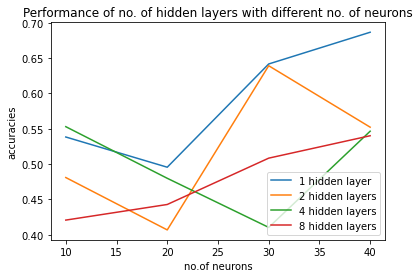

In [101]:
sns.lineplot(x = [10,20,30,40],y = avg_test_1)
sns.lineplot(x = [10,20,30,40],y = avg_test_2)
sns.lineplot(x = [10,20,30,40],y = avg_test_4)
sns.lineplot(x = [10,20,30,40],y = avg_test_8)
plt.title('Performance of no. of hidden layers with different no. of neurons')
plt.ylabel('accuracies')
plt.xlabel('no.of neurons')
plt.legend(['1 hidden layer', '2 hidden layers','4 hidden layers','8 hidden layers'], loc='lower right')

# choose the best validation accuracy

In [102]:
v_10 = np.mean(val_acc_10)
v_20 = np.mean(val_acc_20)
v_30 = np.mean(val_acc_30)
v_40 = np.mean(val_acc_40)

v_10_2 = np.mean(val_acc_10_2)
v_20_2 = np.mean(val_acc_20_2)
v_30_2 = np.mean(val_acc_30_2)
v_40_2 = np.mean(val_acc_40_2)

v_10_4 = np.mean(val_acc_10_4)
v_20_4 = np.mean(val_acc_20_4)
v_30_4 = np.mean(val_acc_30_4)
v_40_4 = np.mean(val_acc_40_4)

v_10_8 = np.mean(val_acc_10_8)
v_20_8 = np.mean(val_acc_20_8)
v_30_8 = np.mean(val_acc_30_8)
v_40_8 = np.mean(val_acc_40_8)

v = [v_10,v_20,v_30,v_40,v_10_2,v_20_2,v_30_2,v_40_2,v_10_4,v_20_4,v_30_4,v_40_4,v_10_8,v_20_8,v_30_8,v_40_8]

print(np.argmax(v))

13


8 layers, 10 nerouns

# Learning rate & optimizers

## AdamW

In [46]:
def eight_hidden(i,j):
    model = Sequential()
    model.add(Dense(i,input_dim = x_train_new.shape[1]))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(6))
    model.add(Activation("relu"))
    optimizer = tfa.optimizers.AdamW(learning_rate = j, weight_decay = 0.0001)
    model.compile(loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True), optimizer =optimizer, metrics = ['accuracy'])
    filepath="best_model.hdf5"
    checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy',verbose=1,save_best_only=True, mode='max')
    history = model.fit(x_train_new,y_train,validation_data = [x_val_new,y_val], epochs = 500,batch_size = 128, verbose = True, callbacks=[checkpoint])
    y_pred = model.predict(x_test_new)
    y_pred_baseline = []
    for i in range(len(y_pred)):
        y_pred_baseline.append(np.argmax(y_pred[i]))
    acc = accuracy_score(y_test,y_pred_baseline)
    return acc, model, filepath

In [54]:
train_acc_lr1_a = []
test_acc_lr1_a = []
val_acc_lr1_a = []

for i in range(5):
    acc_lr1_a,model_lr1_a,filepath = eight_hidden(20,0.01)
    model_lr1_a.load_weights(filepath)
    train_acc_lr1_a.append(model_lr1_a.evaluate(x_train_new, y_train)[1])
    test_acc_lr1_a.append(model_lr1_a.evaluate(x_test_new, y_test)[1])
    val_acc_lr1_a.append(model_lr1_a.evaluate(x_val_new, y_val)[1])

Epoch 1/500
 1/21 [>.............................] - ETA: 11s - loss: 1.7979 - accuracy: 0.1328
Epoch 1: val_accuracy improved from -inf to 0.25134, saving model to best_model.hdf5
21/21 [==============================] - 1s 12ms/step - loss: 1.6171 - accuracy: 0.2837 - val_loss: 2.1866 - val_accuracy: 0.2513
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.2796 - accuracy: 0.4844
Epoch 2: val_accuracy did not improve from 0.25134
21/21 [==============================] - 0s 2ms/step - loss: 1.1412 - accuracy: 0.4746 - val_loss: 3.2882 - val_accuracy: 0.2228
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.0638 - accuracy: 0.4922
Epoch 3: val_accuracy did not improve from 0.25134
21/21 [==============================] - 0s 3ms/step - loss: 0.9853 - accuracy: 0.5147 - val_loss: 3.4083 - val_accuracy: 0.2353
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.0080 - accuracy: 0.5938
Epoch 4: val_accuracy did not improve from 0

In [52]:
train_acc_lr2_a = []
test_acc_lr2_a = []
val_acc_lr2_a = []

for i in range(5):
    acc_lr2_a,model_lr2_a,filepath = eight_hidden(20,0.01)
    model_lr2_a.load_weights(filepath)
    train_acc_lr2_a.append(model_lr2_a.evaluate(x_train_new, y_train)[1])
    test_acc_lr2_a.append(model_lr2_a.evaluate(x_test_new, y_test)[1])
    val_acc_lr2_a.append(model_lr2_a.evaluate(x_val_new, y_val)[1])

Epoch 1/500
 1/21 [>.............................] - ETA: 11s - loss: 1.8013 - accuracy: 0.0391
Epoch 1: val_accuracy improved from -inf to 0.19430, saving model to best_model.hdf5
21/21 [==============================] - 1s 11ms/step - loss: 1.6241 - accuracy: 0.3016 - val_loss: 2.2566 - val_accuracy: 0.1943
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.2362 - accuracy: 0.4922
Epoch 2: val_accuracy improved from 0.19430 to 0.24599, saving model to best_model.hdf5
21/21 [==============================] - 0s 4ms/step - loss: 1.1566 - accuracy: 0.5273 - val_loss: 3.1274 - val_accuracy: 0.2460
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.0128 - accuracy: 0.5781
Epoch 3: val_accuracy did not improve from 0.24599
21/21 [==============================] - 0s 3ms/step - loss: 0.9866 - accuracy: 0.5830 - val_loss: 3.8318 - val_accuracy: 0.2299
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 0.9401 - accuracy: 0.6562
Epoch 4

In [48]:
train_acc_lr3_a = []
test_acc_lr3_a = []
val_acc_lr3_a = []

for i in range(5):
    acc_lr3_a,model_lr3_a,filepath = eight_hidden(20,0.001)
    model_lr3_a.load_weights(filepath)
    train_acc_lr3_a.append(model_lr3_a.evaluate(x_train_new, y_train)[1])
    test_acc_lr3_a.append(model_lr3_a.evaluate(x_test_new, y_test)[1])
    val_acc_lr3_a.append(model_lr3_a.evaluate(x_val_new, y_val)[1])

Epoch 1/500
 1/21 [>.............................] - ETA: 15s - loss: 1.7882 - accuracy: 0.1250
Epoch 1: val_accuracy improved from -inf to 0.16221, saving model to best_model.hdf5
21/21 [==============================] - 1s 12ms/step - loss: 1.7565 - accuracy: 0.3246 - val_loss: 1.8116 - val_accuracy: 0.1622
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7340 - accuracy: 0.3516
Epoch 2: val_accuracy improved from 0.16221 to 0.18004, saving model to best_model.hdf5
21/21 [==============================] - 0s 5ms/step - loss: 1.6395 - accuracy: 0.4086 - val_loss: 1.9475 - val_accuracy: 0.1800
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.5230 - accuracy: 0.5078
Epoch 3: val_accuracy improved from 0.18004 to 0.19073, saving model to best_model.hdf5
21/21 [==============================] - 0s 5ms/step - loss: 1.5016 - accuracy: 0.4815 - val_loss: 2.2222 - val_accuracy: 0.1907
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - lo

In [55]:
print(acc_lr1_a)
table(train_acc_lr1_a,test_acc_lr1_a,val_acc_lr1_a)

0.6755793226381461
Min training acc:  0.4287896156311035
Max training acc:  0.5601374506950378
Avg training acc:  0.49935089945793154
Min testing acc:  0.39393940567970276
Max testing acc:  0.5614973306655884
Avg testing acc:  0.4716577589511871
Min validation acc:  0.2513369023799896
Max validation acc:  0.26737967133522034
Avg validation acc:  0.2563279867172241


In [53]:
print(acc_lr2_a)
table(train_acc_lr2_a,test_acc_lr2_a,val_acc_lr2_a)

0.5775401069518716
Min training acc:  0.4543718993663788
Max training acc:  0.6636120676994324
Avg training acc:  0.571210378408432
Min testing acc:  0.44563278555870056
Max testing acc:  0.648841381072998
Avg testing acc:  0.5511586487293243
Min validation acc:  0.24064171314239502
Max validation acc:  0.2549019753932953
Avg validation acc:  0.24598931074142455


In [51]:
print(acc_lr3_a)
table(train_acc_lr3_a,test_acc_lr3_a,val_acc_lr3_a)

0.5793226381461676
Min training acc:  0.334860622882843
Max training acc:  0.5853379368782043
Avg training acc:  0.47857962250709535
Min testing acc:  0.3226381540298462
Max testing acc:  0.5436720252037048
Avg testing acc:  0.4527629196643829
Min validation acc:  0.2245989292860031
Max validation acc:  0.2513369023799896
Avg validation acc:  0.24099821746349334


## SGD

In [65]:
def SGD(i,j,k):
    model = Sequential()
    model.add(Dense(i,input_dim = x_train_new.shape[1]))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(6))
    model.add(Activation("relu"))
    optimizer = tf.keras.optimizers.SGD(learning_rate=j, momentum=k)
    model.compile(loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True), optimizer =optimizer, metrics = ['accuracy'])
    filepath="best_model.hdf5"
    checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy',verbose=1,save_best_only=True, mode='max')
    history = model.fit(x_train_new,y_train,validation_data = [x_val_new,y_val], epochs = 500,batch_size = 128, verbose = True, callbacks=[checkpoint])
    y_pred = model.predict(x_test_new)
    y_pred_baseline = []
    for i in range(len(y_pred)):
        y_pred_baseline.append(np.argmax(y_pred[i]))
    acc = accuracy_score(y_test,y_pred_baseline)
    return acc, model, filepath

In [66]:
train_lr1_m1 = []
test_lr1_m1 = []
val_lr1_m1 = []

for i in range(5):
    acc_lr1_m1, model_lr1_m1, filepath= SGD(20,0.1,0.1)
    model_lr1_m1.load_weights(filepath)
    train_lr1_m1.append(model_lr1_m1.evaluate(x_train_new, y_train)[1])
    test_lr1_m1.append(model_lr1_m1.evaluate(x_test_new, y_test)[1])
    val_lr1_m1.append(model_lr1_m1.evaluate(x_val_new, y_val)[1]) 

Epoch 1/500
 1/21 [>.............................] - ETA: 13s - loss: 1.7883 - accuracy: 0.1016
Epoch 1: val_accuracy improved from -inf to 0.21212, saving model to best_model.hdf5
21/21 [==============================] - 1s 11ms/step - loss: 1.7424 - accuracy: 0.3070 - val_loss: 1.7447 - val_accuracy: 0.2121
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.6861 - accuracy: 0.3594
Epoch 2: val_accuracy did not improve from 0.21212
21/21 [==============================] - 0s 2ms/step - loss: 1.6012 - accuracy: 0.3799 - val_loss: 1.8408 - val_accuracy: 0.1961
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.4774 - accuracy: 0.3906
Epoch 3: val_accuracy improved from 0.21212 to 0.21569, saving model to best_model.hdf5
21/21 [==============================] - 0s 4ms/step - loss: 1.4550 - accuracy: 0.4116 - val_loss: 1.9531 - val_accuracy: 0.2157
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.4127 - accuracy: 0.4922
Epoch 4

In [68]:
train_lr1_m2 = []
test_lr1_m2 = []
val_lr1_m2 = []

for i in range(5):
    acc_lr1_m2, model_lr1_m2, filepath= SGD(20,0.1,0.5)
    model_lr1_m2.load_weights(filepath)
    train_lr1_m2.append(model_lr1_m2.evaluate(x_train_new, y_train)[1])
    test_lr1_m2.append(model_lr1_m2.evaluate(x_test_new, y_test)[1])
    val_lr1_m2.append(model_lr1_m2.evaluate(x_val_new, y_val)[1]) 

Epoch 1/500
 1/21 [>.............................] - ETA: 8s - loss: 1.7928 - accuracy: 0.0938
Epoch 1: val_accuracy improved from -inf to 0.24955, saving model to best_model.hdf5
21/21 [==============================] - 1s 11ms/step - loss: 1.7607 - accuracy: 0.2413 - val_loss: 1.7609 - val_accuracy: 0.2496
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7259 - accuracy: 0.2500
Epoch 2: val_accuracy did not improve from 0.24955
21/21 [==============================] - 0s 3ms/step - loss: 1.6596 - accuracy: 0.3181 - val_loss: 1.8890 - val_accuracy: 0.1747
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.5139 - accuracy: 0.3828
Epoch 3: val_accuracy did not improve from 0.24955
21/21 [==============================] - 0s 3ms/step - loss: 1.4169 - accuracy: 0.4761 - val_loss: 2.1976 - val_accuracy: 0.1676
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.2521 - accuracy: 0.5000
Epoch 4: val_accuracy did not improve from 0.

In [70]:
train_lr1_m3 = []
test_lr1_m3 = []
val_lr1_m3 = []

for i in range(5):
    acc_lr1_m3, model_lr1_m3, filepath= SGD(20,0.1,0.1)
    model_lr1_m3.load_weights(filepath)
    train_lr1_m3.append(model_lr1_m3.evaluate(x_train_new, y_train)[1])
    test_lr1_m3.append(model_lr1_m3.evaluate(x_test_new, y_test)[1])
    val_lr1_m3.append(model_lr1_m3.evaluate(x_val_new, y_val)[1]) 

Epoch 1/500
 1/21 [>.............................] - ETA: 8s - loss: 1.7905 - accuracy: 0.1406
Epoch 1: val_accuracy improved from -inf to 0.24421, saving model to best_model.hdf5
21/21 [==============================] - 1s 11ms/step - loss: 1.7577 - accuracy: 0.2772 - val_loss: 1.7550 - val_accuracy: 0.2442
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7051 - accuracy: 0.3281
Epoch 2: val_accuracy did not improve from 0.24421
21/21 [==============================] - 0s 3ms/step - loss: 1.6178 - accuracy: 0.3559 - val_loss: 1.8585 - val_accuracy: 0.2103
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.4915 - accuracy: 0.3750
Epoch 3: val_accuracy did not improve from 0.24421
21/21 [==============================] - 0s 3ms/step - loss: 1.4281 - accuracy: 0.3891 - val_loss: 2.0818 - val_accuracy: 0.2264
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.4045 - accuracy: 0.4297
Epoch 4: val_accuracy did not improve from 0.

In [71]:
train_lr2_m1 = []
test_lr2_m1 = []
val_lr2_m1 = []

for i in range(5):
    acc_lr2_m1, model_lr2_m1, filepath= SGD(20,0.01,0.1)
    model_lr2_m1.load_weights(filepath)
    train_lr2_m1.append(model_lr2_m1.evaluate(x_train_new, y_train)[1])
    test_lr2_m1.append(model_lr2_m1.evaluate(x_test_new, y_test)[1])
    val_lr2_m1.append(model_lr2_m1.evaluate(x_val_new, y_val)[1]) 

Epoch 1/500
 1/21 [>.............................] - ETA: 10s - loss: 1.7898 - accuracy: 0.2656
Epoch 1: val_accuracy improved from -inf to 0.24421, saving model to best_model.hdf5
21/21 [==============================] - 1s 13ms/step - loss: 1.7901 - accuracy: 0.2509 - val_loss: 1.7890 - val_accuracy: 0.2442
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7871 - accuracy: 0.2734
Epoch 2: val_accuracy improved from 0.24421 to 0.25134, saving model to best_model.hdf5
21/21 [==============================] - 0s 5ms/step - loss: 1.7862 - accuracy: 0.2574 - val_loss: 1.7856 - val_accuracy: 0.2513
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7880 - accuracy: 0.2266
Epoch 3: val_accuracy did not improve from 0.25134
21/21 [==============================] - 0s 3ms/step - loss: 1.7828 - accuracy: 0.2554 - val_loss: 1.7827 - val_accuracy: 0.2513
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7764 - accuracy: 0.2891
Epoch 4

In [72]:
train_lr2_m2 = []
test_lr2_m2 = []
val_lr2_m2 = []

for i in range(5):
    acc_lr2_m2, model_lr2_m2, filepath= SGD(20,0.01,0.5)
    model_lr2_m2.load_weights(filepath)
    train_lr2_m2.append(model_lr2_m2.evaluate(x_train_new, y_train)[1])
    test_lr2_m2.append(model_lr2_m2.evaluate(x_test_new, y_test)[1])
    val_lr2_m2.append(model_lr2_m2.evaluate(x_val_new, y_val)[1]) 

Epoch 1/500
 1/21 [>.............................] - ETA: 10s - loss: 1.7916 - accuracy: 0.1641
Epoch 1: val_accuracy improved from -inf to 0.25134, saving model to best_model.hdf5
21/21 [==============================] - 1s 15ms/step - loss: 1.7889 - accuracy: 0.2352 - val_loss: 1.7866 - val_accuracy: 0.2513
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7851 - accuracy: 0.2812
Epoch 2: val_accuracy did not improve from 0.25134
21/21 [==============================] - 0s 3ms/step - loss: 1.7839 - accuracy: 0.2539 - val_loss: 1.7829 - val_accuracy: 0.2513
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7741 - accuracy: 0.3203
Epoch 3: val_accuracy did not improve from 0.25134
21/21 [==============================] - 0s 3ms/step - loss: 1.7797 - accuracy: 0.2543 - val_loss: 1.7798 - val_accuracy: 0.2513
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7790 - accuracy: 0.2422
Epoch 4: val_accuracy did not improve from 0

In [73]:
train_lr2_m3 = []
test_lr2_m3 = []
val_lr2_m3 = []

for i in range(5):
    acc_lr2_m3, model_lr2_m3, filepath= SGD(20,0.01,0.9)
    model_lr2_m3.load_weights(filepath)
    train_lr2_m3.append(model_lr2_m3.evaluate(x_train_new, y_train)[1])
    test_lr2_m3.append(model_lr2_m3.evaluate(x_test_new, y_test)[1])
    val_lr2_m3.append(model_lr2_m3.evaluate(x_val_new, y_val)[1]) 

Epoch 1/500
 1/21 [>.............................] - ETA: 10s - loss: 1.7934 - accuracy: 0.2734
Epoch 1: val_accuracy improved from -inf to 0.25134, saving model to best_model.hdf5
21/21 [==============================] - 1s 12ms/step - loss: 1.7778 - accuracy: 0.2650 - val_loss: 1.7564 - val_accuracy: 0.2513
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7455 - accuracy: 0.2891
Epoch 2: val_accuracy did not improve from 0.25134
21/21 [==============================] - 0s 2ms/step - loss: 1.7445 - accuracy: 0.2543 - val_loss: 1.7442 - val_accuracy: 0.2513
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.6977 - accuracy: 0.2969
Epoch 3: val_accuracy did not improve from 0.25134
21/21 [==============================] - 0s 2ms/step - loss: 1.7098 - accuracy: 0.2952 - val_loss: 1.7569 - val_accuracy: 0.2175
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.6855 - accuracy: 0.3672
Epoch 4: val_accuracy did not improve from 0

In [74]:
train_lr3_m1 = []
test_lr3_m1 = []
val_lr3_m1 = []

for i in range(5):
    acc_lr3_m1, model_lr3_m1, filepath= SGD(20,0.001,0.1)
    model_lr3_m1.load_weights(filepath)
    train_lr3_m1.append(model_lr3_m1.evaluate(x_train_new, y_train)[1])
    test_lr3_m1.append(model_lr3_m1.evaluate(x_test_new, y_test)[1])
    val_lr3_m1.append(model_lr3_m1.evaluate(x_val_new, y_val)[1]) 

Epoch 1/500
 1/21 [>.............................] - ETA: 10s - loss: 1.7851 - accuracy: 0.2734
Epoch 1: val_accuracy improved from -inf to 0.25134, saving model to best_model.hdf5
21/21 [==============================] - 1s 13ms/step - loss: 1.7866 - accuracy: 0.2547 - val_loss: 1.7848 - val_accuracy: 0.2513
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7835 - accuracy: 0.2500
Epoch 2: val_accuracy did not improve from 0.25134
21/21 [==============================] - 0s 2ms/step - loss: 1.7853 - accuracy: 0.2543 - val_loss: 1.7838 - val_accuracy: 0.2513
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7876 - accuracy: 0.2109
Epoch 3: val_accuracy did not improve from 0.25134
21/21 [==============================] - 0s 2ms/step - loss: 1.7842 - accuracy: 0.2543 - val_loss: 1.7828 - val_accuracy: 0.2513
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7816 - accuracy: 0.2422
Epoch 4: val_accuracy did not improve from 0

In [75]:
train_lr3_m2 = []
test_lr3_m2 = []
val_lr3_m2 = []

for i in range(5):
    acc_lr3_m2, model_lr3_m2, filepath= SGD(20,0.001,0.5)
    model_lr3_m2.load_weights(filepath)
    train_lr3_m2.append(model_lr3_m2.evaluate(x_train_new, y_train)[1])
    test_lr3_m2.append(model_lr3_m2.evaluate(x_test_new, y_test)[1])
    val_lr3_m2.append(model_lr3_m2.evaluate(x_val_new, y_val)[1]) 

Epoch 1/500
 1/21 [>.............................] - ETA: 10s - loss: 1.7895 - accuracy: 0.1641
Epoch 1: val_accuracy improved from -inf to 0.18360, saving model to best_model.hdf5
21/21 [==============================] - 1s 12ms/step - loss: 1.7888 - accuracy: 0.2115 - val_loss: 1.7910 - val_accuracy: 0.1836
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7865 - accuracy: 0.2422
Epoch 2: val_accuracy improved from 0.18360 to 0.19430, saving model to best_model.hdf5
21/21 [==============================] - 0s 4ms/step - loss: 1.7880 - accuracy: 0.2329 - val_loss: 1.7907 - val_accuracy: 0.1943
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7833 - accuracy: 0.2969
Epoch 3: val_accuracy improved from 0.19430 to 0.19786, saving model to best_model.hdf5
21/21 [==============================] - 0s 4ms/step - loss: 1.7873 - accuracy: 0.2363 - val_loss: 1.7904 - val_accuracy: 0.1979
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - lo

In [85]:
train_lr3_m3 = []
test_lr3_m3 = []
val_lr3_m3 = []

for i in range(5):
    acc_lr3_m3, model_lr3_m3, filepath= SGD(20,0.001,0.9)
    model_lr3_m3.load_weights(filepath)
    train_lr3_m3.append(model_lr3_m3.evaluate(x_train_new, y_train)[1])
    test_lr3_m3.append(model_lr3_m3.evaluate(x_test_new, y_test)[1])
    val_lr3_m3.append(model_lr3_m3.evaluate(x_val_new, y_val)[1]) 

Epoch 1/500
 1/21 [>.............................] - ETA: 8s - loss: 1.7820 - accuracy: 0.2734
Epoch 1: val_accuracy improved from -inf to 0.25134, saving model to best_model.hdf5
21/21 [==============================] - 1s 11ms/step - loss: 1.7877 - accuracy: 0.2543 - val_loss: 1.7839 - val_accuracy: 0.2513
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7803 - accuracy: 0.2578
Epoch 2: val_accuracy did not improve from 0.25134
21/21 [==============================] - 0s 3ms/step - loss: 1.7840 - accuracy: 0.2543 - val_loss: 1.7819 - val_accuracy: 0.2513
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7888 - accuracy: 0.2422
Epoch 3: val_accuracy did not improve from 0.25134
21/21 [==============================] - 0s 3ms/step - loss: 1.7802 - accuracy: 0.2543 - val_loss: 1.7797 - val_accuracy: 0.2513
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7767 - accuracy: 0.2812
Epoch 4: val_accuracy did not improve from 0.

In [67]:
table(train_lr1_m1,test_lr1_m1,val_lr1_m1)

Min training acc:  0.22031310200691223
Max training acc:  0.5811378359794617
Avg training acc:  0.4807942032814026
Min testing acc:  0.21746881306171417
Max testing acc:  0.5258467197418213
Avg testing acc:  0.44812835156917574
Min validation acc:  0.2442067712545395
Max validation acc:  0.26737967133522034
Avg validation acc:  0.2559714764356613


In [76]:
table(train_lr1_m2,test_lr1_m2,val_lr1_m2)

Min training acc:  0.2722413241863251
Max training acc:  0.5544100999832153
Avg training acc:  0.4064910411834717
Min testing acc:  0.24242424964904785
Max testing acc:  0.5401069521903992
Avg testing acc:  0.3935828864574432
Min validation acc:  0.24242424964904785
Max validation acc:  0.26203209161758423
Avg validation acc:  0.25062389075756075


In [77]:
table(train_lr1_m3,test_lr1_m3,val_lr1_m3)

Min training acc:  0.2542955279350281
Max training acc:  0.6074837446212769
Avg training acc:  0.4410080134868622
Min testing acc:  0.22638146579265594
Max testing acc:  0.5614973306655884
Avg testing acc:  0.4035650700330734
Min validation acc:  0.23529411852359772
Max validation acc:  0.270944744348526
Avg validation acc:  0.2513369023799896


In [78]:
table(train_lr2_m1,test_lr2_m1,val_lr2_m1)

Min training acc:  0.266132116317749
Max training acc:  0.5891561508178711
Avg training acc:  0.404276442527771
Min testing acc:  0.22638146579265594
Max testing acc:  0.5828877091407776
Avg testing acc:  0.37932264506816865
Min validation acc:  0.2245989292860031
Max validation acc:  0.2852049767971039
Avg validation acc:  0.2613190680742264


In [79]:
table(train_lr2_m2,test_lr2_m2,val_lr2_m2)

Min training acc:  0.21420389413833618
Max training acc:  0.5418098568916321
Avg training acc:  0.3415807545185089
Min testing acc:  0.21746881306171417
Max testing acc:  0.48306596279144287
Avg testing acc:  0.31265597939491274
Min validation acc:  0.2549019753932953
Max validation acc:  0.270944744348526
Avg validation acc:  0.26167558431625365


In [80]:
table(train_lr2_m3,test_lr2_m3,val_lr2_m3)

Min training acc:  0.22909507155418396
Max training acc:  0.5922107696533203
Avg training acc:  0.35211912989616395
Min testing acc:  0.22638146579265594
Max testing acc:  0.5401069521903992
Avg testing acc:  0.3286987543106079
Min validation acc:  0.24242424964904785
Max validation acc:  0.270944744348526
Avg validation acc:  0.251693406701088


In [81]:
table(train_lr3_m1,test_lr3_m1,val_lr3_m1)

Min training acc:  0.25124093890190125
Max training acc:  0.4070255756378174
Avg training acc:  0.2856815576553345
Min testing acc:  0.22103387117385864
Max testing acc:  0.37789660692214966
Avg testing acc:  0.2677361875772476
Min validation acc:  0.2192513346672058
Max validation acc:  0.26737967133522034
Avg validation acc:  0.25098039507865905


In [82]:
table(train_lr3_m2,test_lr3_m2,val_lr3_m2)

Min training acc:  0.21420389413833618
Max training acc:  0.35395190119743347
Avg training acc:  0.26857579946517945
Min testing acc:  0.21746881306171417
Max testing acc:  0.3957219123840332
Avg testing acc:  0.27629233300685885
Min validation acc:  0.22816398739814758
Max validation acc:  0.2549019753932953
Avg validation acc:  0.24527629911899568


In [86]:
table(train_lr3_m3,test_lr3_m3,val_lr3_m3)

Min training acc:  0.24780450761318207
Max training acc:  0.6296296119689941
Avg training acc:  0.4847651690244675
Min testing acc:  0.28342247009277344
Max testing acc:  0.6131907105445862
Avg testing acc:  0.48021390438079836
Min validation acc:  0.22816398739814758
Max validation acc:  0.2549019753932953
Avg validation acc:  0.24242424368858337


## Rprop

In [87]:
def Rprop(i,k):
    model = Sequential()
    model.add(Dense(i,input_dim = x_train_new.shape[1]))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(i))
    model.add(Activation("relu"))
    model.add(Dense(6))
    model.add(Activation("relu"))
    optimizer = tf.keras.optimizers.RMSprop(learning_rate=k)
    model.compile(loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True), optimizer =optimizer, metrics = ['accuracy'])
    filepath="best_model.hdf5"
    checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy',verbose=1,save_best_only=True, mode='max')
    history = model.fit(x_train_new,y_train,validation_data = [x_val_new,y_val], epochs = 500,batch_size = 128, verbose = True, callbacks=[checkpoint])
    y_pred = model.predict(x_test_new)
    y_pred_baseline = []
    for i in range(len(y_pred)):
        y_pred_baseline.append(np.argmax(y_pred[i]))
    acc = accuracy_score(y_test,y_pred_baseline)
    return acc, model, filepath

In [88]:
train_lr1_r = []
test_lr1_r = []
val_lr1_r = []

for i in range(5):
    acc_lr1_r, model_lr1_r, filepath= Rprop(20,0.1)
    model_lr1_r.load_weights(filepath)
    train_lr1_r.append(model_lr1_r.evaluate(x_train_new, y_train)[1])
    test_lr1_r.append(model_lr1_r.evaluate(x_test_new, y_test)[1])
    val_lr1_r.append(model_lr1_r.evaluate(x_val_new, y_val)[1])  

Epoch 1/500
 1/21 [>.............................] - ETA: 44s - loss: 1.7940 - accuracy: 0.1172
Epoch 1: val_accuracy improved from -inf to 0.25134, saving model to best_model.hdf5
21/21 [==============================] - 3s 25ms/step - loss: 8.7103 - accuracy: 0.2432 - val_loss: 1.7451 - val_accuracy: 0.2513
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7089 - accuracy: 0.3281
Epoch 2: val_accuracy did not improve from 0.25134
21/21 [==============================] - 0s 4ms/step - loss: 1.7548 - accuracy: 0.2425 - val_loss: 1.7576 - val_accuracy: 0.2513
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7594 - accuracy: 0.2734
Epoch 3: val_accuracy did not improve from 0.25134
21/21 [==============================] - 0s 3ms/step - loss: 1.7558 - accuracy: 0.2509 - val_loss: 1.7326 - val_accuracy: 0.2513
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7535 - accuracy: 0.2266
Epoch 4: val_accuracy did not improve from 0

In [89]:
train_lr2_r = []
test_lr2_r = []
val_lr2_r = []

for i in range(5):
    acc_lr2_r, model_lr2_r, filepath= Rprop(20,0.01)
    model_lr2_r.load_weights(filepath)
    train_lr2_r.append(model_lr2_r.evaluate(x_train_new, y_train)[1])
    test_lr2_r.append(model_lr2_r.evaluate(x_test_new, y_test)[1])
    val_lr2_r.append(model_lr2_r.evaluate(x_val_new, y_val)[1])  

Epoch 1/500
 1/21 [>.............................] - ETA: 40s - loss: 1.7917 - accuracy: 0.1641
Epoch 1: val_accuracy improved from -inf to 0.20499, saving model to best_model.hdf5
21/21 [==============================] - 2s 13ms/step - loss: 1.3888 - accuracy: 0.3803 - val_loss: 3.0185 - val_accuracy: 0.2050
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.2096 - accuracy: 0.4219
Epoch 2: val_accuracy did not improve from 0.20499
21/21 [==============================] - 0s 3ms/step - loss: 0.9586 - accuracy: 0.5353 - val_loss: 3.6357 - val_accuracy: 0.1872
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 0.9501 - accuracy: 0.4844
Epoch 3: val_accuracy did not improve from 0.20499
21/21 [==============================] - 0s 4ms/step - loss: 0.8520 - accuracy: 0.5968 - val_loss: 4.6199 - val_accuracy: 0.1818
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 0.7710 - accuracy: 0.6094
Epoch 4: val_accuracy improved from 0.20499 

In [90]:
train_lr3_r = []
test_lr3_r = []
val_lr3_r = []

for i in range(5):
    acc_lr3_r, model_lr3_r, filepath= Rprop(20,0.001)
    model_lr3_r.load_weights(filepath)
    train_lr3_r.append(model_lr3_r.evaluate(x_train_new, y_train)[1])
    test_lr3_r.append(model_lr3_r.evaluate(x_test_new, y_test)[1])
    val_lr3_r.append(model_lr3_r.evaluate(x_val_new, y_val)[1])  

Epoch 1/500
19/21 [==========================>...] - ETA: 0s - loss: 1.7065 - accuracy: 0.3359 
Epoch 1: val_accuracy improved from -inf to 0.20499, saving model to best_model.hdf5
21/21 [==============================] - 3s 28ms/step - loss: 1.6980 - accuracy: 0.3417 - val_loss: 1.7811 - val_accuracy: 0.2050
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.6262 - accuracy: 0.3672
Epoch 2: val_accuracy did not improve from 0.20499
21/21 [==============================] - 0s 4ms/step - loss: 1.4450 - accuracy: 0.4471 - val_loss: 1.9221 - val_accuracy: 0.2014
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.3413 - accuracy: 0.4453
Epoch 3: val_accuracy did not improve from 0.20499
21/21 [==============================] - 0s 3ms/step - loss: 1.2067 - accuracy: 0.4987 - val_loss: 2.2409 - val_accuracy: 0.1979
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.1580 - accuracy: 0.5547
Epoch 4: val_accuracy did not improve from 0

In [91]:
table(train_lr1_r,test_lr1_r,val_lr1_r)

Min training acc:  0.21420389413833618
Max training acc:  0.40817105770111084
Avg training acc:  0.2690339803695679
Min testing acc:  0.21746881306171417
Max testing acc:  0.38680925965309143
Avg testing acc:  0.2549019634723663
Min validation acc:  0.2513369023799896
Max validation acc:  0.2655971348285675
Avg validation acc:  0.2556149780750275


In [92]:
table(train_lr2_r,test_lr2_r,val_lr2_r)

Min training acc:  0.5139366388320923
Max training acc:  0.8285605311393738
Avg training acc:  0.6361206650733948
Min testing acc:  0.488413542509079
Max testing acc:  0.7504456043243408
Avg testing acc:  0.5921568632125854
Min validation acc:  0.22281639277935028
Max validation acc:  0.26737967133522034
Avg validation acc:  0.24385026693344117


In [93]:
table(train_lr3_r,test_lr3_r,val_lr3_r)

Min training acc:  0.21420389413833618
Max training acc:  0.650629997253418
Avg training acc:  0.47567774057388307
Min testing acc:  0.21746881306171417
Max testing acc:  0.5953654050827026
Avg testing acc:  0.45846701562404635
Min validation acc:  0.21033868193626404
Max validation acc:  0.26203209161758423
Avg validation acc:  0.23743315935134887


## Accuracy

In [95]:
v_lr1_a = np.mean(val_acc_lr1_a)
v_lr1_m1 = np.mean(val_lr1_m1)
v_lr1_m2 = np.mean(val_lr1_m2)
v_lr1_m3 = np.mean(val_lr1_m3)
v_lr1_r = np.mean(val_lr1_r)
v_lr1 = [v_lr1_a,v_lr1_m1,v_lr1_m2,v_lr1_m3,v_lr1_r]
v_lr1

[0.2563279867172241,
 0.2559714764356613,
 0.25062389075756075,
 0.2513369023799896,
 0.2556149780750275]

In [97]:
v_lr2_a = np.mean(val_acc_lr2_a)
v_lr2_m1 = np.mean(val_lr2_m1)
v_lr2_m2 = np.mean(val_lr2_m2)
v_lr2_m3 = np.mean(val_lr2_m3)
v_lr2_r = np.mean(val_lr2_r)
v_lr2 = [v_lr2_a,v_lr2_m1,v_lr2_m2,v_lr2_m3,v_lr2_r]
v_lr2

[0.24598931074142455,
 0.2613190680742264,
 0.26167558431625365,
 0.251693406701088,
 0.24385026693344117]

In [98]:
v_lr3_a = np.mean(val_lr3_a)
v_lr3_m1 = np.mean(val_lr3_m1)
v_lr3_m2 = np.mean(val_lr3_m2)
v_lr3_m3 = np.mean(val_lr3_m3)
v_lr3_r = np.mean(val_lr3_r)
v_lr3 = [v_lr3_a,v_lr3_m1,v_lr3_m2,v_lr3_m3,v_lr3_r]
v_lr3

[0.2549019753932953,
 0.25098039507865905,
 0.24527629911899568,
 0.24242424368858337,
 0.23743315935134887]

# Activation function

In [99]:
def Active(i,j,k,a):
    model = Sequential()
    model.add(Dense(i,input_dim = x_train_new.shape[1]))
    model.add(Activation(a))
    model.add(Dense(i))
    model.add(Activation(a))
    model.add(Dense(i))
    model.add(Activation(a))
    model.add(Dense(i))
    model.add(Activation(a))
    model.add(Dense(i))
    model.add(Activation(a))
    model.add(Dense(i))
    model.add(Activation(a))
    model.add(Dense(i))
    model.add(Activation(a))
    model.add(Dense(i))
    model.add(Activation(a))
    model.add(Dense(6))
    model.add(Activation(a))
    optimizer = tf.keras.optimizers.SGD(learning_rate=j, momentum=k)
    model.compile(loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True), optimizer =optimizer, metrics = ['accuracy'])
    filepath="best_model.hdf5"
    checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy',verbose=1,save_best_only=True, mode='max')
    history = model.fit(x_train_new,y_train,validation_data = [x_val_new,y_val], epochs = 500,batch_size = 128, verbose = True, callbacks=[checkpoint])
    y_pred = model.predict(x_test_new)
    y_pred_baseline = []
    for i in range(len(y_pred)):
        y_pred_baseline.append(np.argmax(y_pred[i]))
    acc = accuracy_score(y_test,y_pred_baseline)
    return acc, model, filepath

In [102]:
train_a_r = []
test_a_r = []
val_a_r = []

for i in range(5):
    acc_a_r, model_a_r, filepath= Active(20,0.01,0.5,"relu")
    model_a_r.load_weights(filepath)
    train_a_r.append(model_a_r.evaluate(x_train_new, y_train)[1])
    test_a_r.append(model_a_r.evaluate(x_test_new, y_test)[1])
    val_a_r.append(model_a_r.evaluate(x_val_new, y_val)[1])  

Epoch 1/500
 1/21 [>.............................] - ETA: 23s - loss: 1.7915 - accuracy: 0.2109
Epoch 1: val_accuracy improved from -inf to 0.17469, saving model to best_model.hdf5
21/21 [==============================] - 2s 27ms/step - loss: 1.7980 - accuracy: 0.1558 - val_loss: 1.7932 - val_accuracy: 0.1747
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7916 - accuracy: 0.1719
Epoch 2: val_accuracy improved from 0.17469 to 0.21212, saving model to best_model.hdf5
21/21 [==============================] - 0s 8ms/step - loss: 1.7936 - accuracy: 0.1779 - val_loss: 1.7899 - val_accuracy: 0.2121
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7846 - accuracy: 0.2969
Epoch 3: val_accuracy improved from 0.21212 to 0.25134, saving model to best_model.hdf5
21/21 [==============================] - 0s 8ms/step - loss: 1.7862 - accuracy: 0.2314 - val_loss: 1.7836 - val_accuracy: 0.2513
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - lo

In [103]:
train_lr_r = []
test_lr_r = []
val_lr_r = []

for i in range(5):
    acc_lr_r, model_lr_r, filepath= Active(20,0.01,0.5,tf.keras.layers.LeakyReLU(alpha=0.2))
    model_lr_r.load_weights(filepath)
    train_lr_r.append(model_lr_r.evaluate(x_train_new, y_train)[1])
    test_lr_r.append(model_lr_r.evaluate(x_test_new, y_test)[1])
    val_lr_r.append(model_lr_r.evaluate(x_val_new, y_val)[1])  

Epoch 1/500
18/21 [========================>.....] - ETA: 0s - loss: 1.7825 - accuracy: 0.2591 
Epoch 1: val_accuracy improved from -inf to 0.20856, saving model to best_model.hdf5
21/21 [==============================] - 2s 27ms/step - loss: 1.7813 - accuracy: 0.2631 - val_loss: 1.7871 - val_accuracy: 0.2086
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7806 - accuracy: 0.2812
Epoch 2: val_accuracy improved from 0.20856 to 0.21034, saving model to best_model.hdf5
21/21 [==============================] - 0s 7ms/step - loss: 1.7677 - accuracy: 0.2761 - val_loss: 1.7826 - val_accuracy: 0.2103
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7637 - accuracy: 0.2969
Epoch 3: val_accuracy improved from 0.21034 to 0.21212, saving model to best_model.hdf5
21/21 [==============================] - 0s 8ms/step - loss: 1.7560 - accuracy: 0.2879 - val_loss: 1.7796 - val_accuracy: 0.2121
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - lo

In [115]:
train_a_s = []
test_a_s = []
val_a_s = []

for i in range(5):
    acc_a_s, model_a_s, filepath= Active(20,0.01,0.5,'sigmoid')
    model_a_s.load_weights(filepath)
    train_a_s.append(model_a_s.evaluate(x_train_new, y_train)[1])
    test_a_s.append(model_a_s.evaluate(x_test_new, y_test)[1])
    val_a_s.append(model_a_s.evaluate(x_val_new, y_val)[1])  

Epoch 1/500


C:\Users\EGYPT_LAPTOP\anaconda3\lib\site-packages\tensorflow\python\util\dispatch.py:1082: UserWarning: "`sparse_categorical_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  return dispatch_target(*args, **kwargs)


 1/21 [>.............................] - ETA: 8s - loss: 1.7146 - accuracy: 0.2188
Epoch 1: val_accuracy improved from -inf to 0.25134, saving model to best_model.hdf5
21/21 [==============================] - 1s 12ms/step - loss: 1.6856 - accuracy: 0.2543 - val_loss: 1.6640 - val_accuracy: 0.2513
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.6391 - accuracy: 0.3125
Epoch 2: val_accuracy did not improve from 0.25134
21/21 [==============================] - 0s 3ms/step - loss: 1.6669 - accuracy: 0.2543 - val_loss: 1.6540 - val_accuracy: 0.2513
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7424 - accuracy: 0.2500
Epoch 3: val_accuracy did not improve from 0.25134
21/21 [==============================] - 0s 3ms/step - loss: 1.6576 - accuracy: 0.2543 - val_loss: 1.6487 - val_accuracy: 0.2513
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7092 - accuracy: 0.1875
Epoch 4: val_accuracy did not improve from 0.25134
21/21 

C:\Users\EGYPT_LAPTOP\anaconda3\lib\site-packages\tensorflow\python\util\dispatch.py:1082: UserWarning: "`sparse_categorical_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  return dispatch_target(*args, **kwargs)


 1/21 [>.............................] - ETA: 10s - loss: 2.3136 - accuracy: 0.1797
Epoch 1: val_accuracy improved from -inf to 0.25490, saving model to best_model.hdf5
21/21 [==============================] - 1s 14ms/step - loss: 2.0455 - accuracy: 0.2142 - val_loss: 1.8311 - val_accuracy: 0.2549
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7641 - accuracy: 0.3047
Epoch 2: val_accuracy did not improve from 0.25490
21/21 [==============================] - 0s 2ms/step - loss: 1.7947 - accuracy: 0.2142 - val_loss: 1.7156 - val_accuracy: 0.2549
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7405 - accuracy: 0.1719
Epoch 3: val_accuracy did not improve from 0.25490
21/21 [==============================] - 0s 2ms/step - loss: 1.7106 - accuracy: 0.2142 - val_loss: 1.6774 - val_accuracy: 0.2549
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.6903 - accuracy: 0.1875
Epoch 4: val_accuracy did not improve from 0.25490
21/21

C:\Users\EGYPT_LAPTOP\anaconda3\lib\site-packages\tensorflow\python\util\dispatch.py:1082: UserWarning: "`sparse_categorical_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  return dispatch_target(*args, **kwargs)


 1/21 [>.............................] - ETA: 9s - loss: 2.0347 - accuracy: 0.2266
Epoch 1: val_accuracy improved from -inf to 0.21925, saving model to best_model.hdf5
21/21 [==============================] - 1s 12ms/step - loss: 1.9295 - accuracy: 0.2486 - val_loss: 1.9069 - val_accuracy: 0.2193
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7840 - accuracy: 0.2344
Epoch 2: val_accuracy did not improve from 0.21925
21/21 [==============================] - 0s 2ms/step - loss: 1.7970 - accuracy: 0.2486 - val_loss: 1.7868 - val_accuracy: 0.2193
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7118 - accuracy: 0.3203
Epoch 3: val_accuracy did not improve from 0.21925
21/21 [==============================] - 0s 2ms/step - loss: 1.7232 - accuracy: 0.2447 - val_loss: 1.7195 - val_accuracy: 0.2193
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7172 - accuracy: 0.2266
Epoch 4: val_accuracy did not improve from 0.21925
21/21 

C:\Users\EGYPT_LAPTOP\anaconda3\lib\site-packages\tensorflow\python\util\dispatch.py:1082: UserWarning: "`sparse_categorical_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  return dispatch_target(*args, **kwargs)


 1/21 [>.............................] - ETA: 9s - loss: 1.8295 - accuracy: 0.0938
Epoch 1: val_accuracy improved from -inf to 0.25134, saving model to best_model.hdf5
21/21 [==============================] - 1s 40ms/step - loss: 1.7716 - accuracy: 0.2302 - val_loss: 1.7345 - val_accuracy: 0.2513
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7226 - accuracy: 0.2969
Epoch 2: val_accuracy did not improve from 0.25134
21/21 [==============================] - 0s 2ms/step - loss: 1.7113 - accuracy: 0.2543 - val_loss: 1.6934 - val_accuracy: 0.2513
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.6707 - accuracy: 0.2500
Epoch 3: val_accuracy did not improve from 0.25134
21/21 [==============================] - 0s 2ms/step - loss: 1.6826 - accuracy: 0.2543 - val_loss: 1.6721 - val_accuracy: 0.2513
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.6303 - accuracy: 0.2812
Epoch 4: val_accuracy did not improve from 0.25134
21/21 

C:\Users\EGYPT_LAPTOP\anaconda3\lib\site-packages\tensorflow\python\util\dispatch.py:1082: UserWarning: "`sparse_categorical_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  return dispatch_target(*args, **kwargs)


 1/21 [>.............................] - ETA: 9s - loss: 1.8103 - accuracy: 0.3281
Epoch 1: val_accuracy improved from -inf to 0.25134, saving model to best_model.hdf5
21/21 [==============================] - 1s 12ms/step - loss: 1.8212 - accuracy: 0.2543 - val_loss: 1.7658 - val_accuracy: 0.2513
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.6701 - accuracy: 0.3359
Epoch 2: val_accuracy did not improve from 0.25134
21/21 [==============================] - 0s 2ms/step - loss: 1.7293 - accuracy: 0.2543 - val_loss: 1.7071 - val_accuracy: 0.2513
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.6816 - accuracy: 0.2656
Epoch 3: val_accuracy did not improve from 0.25134
21/21 [==============================] - 0s 2ms/step - loss: 1.6910 - accuracy: 0.2543 - val_loss: 1.6783 - val_accuracy: 0.2513
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.6505 - accuracy: 0.2266
Epoch 4: val_accuracy did not improve from 0.25134
21/21 

In [105]:
train_a_t = []
test_a_t = []
val_a_t = []

for i in range(5):
    acc_a_t, model_a_t, filepath= Active(20,0.01,0.5,"tanh")
    model_a_t.load_weights(filepath)
    train_a_t.append(model_a_t.evaluate(x_train_new, y_train)[1])
    test_a_t.append(model_a_t.evaluate(x_test_new, y_test)[1])
    val_a_t.append(model_a_t.evaluate(x_val_new, y_val)[1])  

Epoch 1/500
19/21 [==========================>...] - ETA: 0s - loss: 1.7391 - accuracy: 0.2299 
Epoch 1: val_accuracy improved from -inf to 0.23173, saving model to best_model.hdf5
21/21 [==============================] - 2s 28ms/step - loss: 1.7295 - accuracy: 0.2386 - val_loss: 1.7368 - val_accuracy: 0.2317
Epoch 2/500
 1/21 [>.............................] - ETA: 0s - loss: 1.5686 - accuracy: 0.4297
Epoch 2: val_accuracy improved from 0.23173 to 0.25134, saving model to best_model.hdf5
21/21 [==============================] - 0s 8ms/step - loss: 1.5213 - accuracy: 0.4124 - val_loss: 1.7464 - val_accuracy: 0.2513
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.4190 - accuracy: 0.4375
Epoch 3: val_accuracy did not improve from 0.25134
21/21 [==============================] - 0s 4ms/step - loss: 1.4033 - accuracy: 0.4872 - val_loss: 1.7800 - val_accuracy: 0.2442
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - loss: 1.3494 - accuracy: 0.5547
Epoch 4

In [106]:
table(train_a_r,test_a_r,val_a_r)

Min training acc:  0.2542955279350281
Max training acc:  0.6609392762184143
Avg training acc:  0.4109201908111572
Min testing acc:  0.23351158201694489
Max testing acc:  0.6221033930778503
Avg testing acc:  0.3807486593723297
Min validation acc:  0.22638146579265594
Max validation acc:  0.2655971348285675
Avg validation acc:  0.25062389075756075


In [107]:
table(train_lr_r,test_lr_r,val_lr_r)

Min training acc:  0.2542955279350281
Max training acc:  0.6559755802154541
Avg training acc:  0.4229858696460724
Min testing acc:  0.22638146579265594
Max testing acc:  0.6524063944816589
Avg testing acc:  0.39893047511577606
Min validation acc:  0.23172906041145325
Max validation acc:  0.25846701860427856
Avg validation acc:  0.24670231938362122


In [116]:
table(train_a_s,test_a_s,val_a_s)

Min training acc:  0.21420389413833618
Max training acc:  0.2542955279350281
Avg training acc:  0.2462772011756897
Min testing acc:  0.21746881306171417
Max testing acc:  0.22638146579265594
Avg testing acc:  0.2245989352464676
Min validation acc:  0.2513369023799896
Max validation acc:  0.2549019753932953
Avg validation acc:  0.2520499169826508


In [109]:
table(train_a_t,test_a_t,val_a_t)

Min training acc:  0.46353569626808167
Max training acc:  0.6185566782951355
Avg training acc:  0.5430316865444184
Min testing acc:  0.4260249435901642
Max testing acc:  0.5882353186607361
Avg testing acc:  0.5133689939975739
Min validation acc:  0.23351158201694489
Max validation acc:  0.2513369023799896
Avg validation acc:  0.24206773936748505


In [162]:
model = Sequential()
model.add(Dense(i,input_dim = x_train_new.shape[1]))
model.add(Activation("relu"))
model.add(Dense(20))
model.add(Activation("relu"))
model.add(Dense(20))
model.add(Activation("relu"))
model.add(Dense(20))
model.add(Activation("relu"))
model.add(Dense(20))
model.add(Activation("relu"))
model.add(Dense(20))
model.add(Activation("relu"))
model.add(Dense(20))
model.add(Activation("relu"))
model.add(Dense(20))
model.add(Activation("relu"))
model.add(Dense(6))
model.add(Activation("relu"))
optimizer = tf.keras.optimizers.SGD(learning_rate=0.01, momentum=0.5)
model.compile(loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True), optimizer =optimizer, metrics = ['accuracy'])
filepath="best_model.hdf5"
checkpoint = ModelCheckpoint(filepath, monitor='val_accuracy',verbose=1,save_best_only=True, mode='max')
history = model.fit(x_train_new,y_train,validation_data = [x_val_new,y_val], epochs = 500,batch_size = 128, verbose = True, callbacks=[checkpoint])
y_pred = model.predict(x_test_new)
y_pred_baseline = []
for i in range(len(y_pred)):
    y_pred_baseline.append(np.argmax(y_pred[i]))
acc = accuracy_score(y_test,y_pred_baseline)

Epoch 1/500
20/21 [===========================>..] - ETA: 0s - loss: 1.7876 - accuracy: 0.2598 
Epoch 1: val_accuracy improved from -inf to 0.20143, saving model to best_model.hdf5
21/21 [==============================] - 2s 33ms/step - loss: 1.7873 - accuracy: 0.2616 - val_loss: 1.7815 - val_accuracy: 0.2014
Epoch 2/500
21/21 [==============================] - ETA: 0s - loss: 1.7734 - accuracy: 0.2673
Epoch 2: val_accuracy improved from 0.20143 to 0.21390, saving model to best_model.hdf5
21/21 [==============================] - 0s 8ms/step - loss: 1.7734 - accuracy: 0.2673 - val_loss: 1.7736 - val_accuracy: 0.2139
Epoch 3/500
 1/21 [>.............................] - ETA: 0s - loss: 1.7650 - accuracy: 0.2656
Epoch 3: val_accuracy improved from 0.21390 to 0.21569, saving model to best_model.hdf5
21/21 [==============================] - 0s 7ms/step - loss: 1.7618 - accuracy: 0.2696 - val_loss: 1.7678 - val_accuracy: 0.2157
Epoch 4/500
 1/21 [>.............................] - ETA: 0s - lo

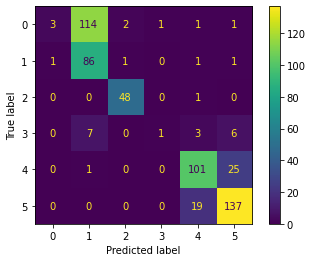

In [163]:
cm = confusion_matrix(y_test,y_pred_baseline)
disp = ConfusionMatrixDisplay(cm)
disp.plot()